# Isar EDA

<h1>Outline</h1>

<a href="#describing"><h2> I.) Description of The Topic And General Questions</h2></a>
<a href="#selection"><h2> II.) Data Selection</h2></a>
<a href="#merge"><h2> III.) Data Merging Process</h2></a>
<a href="#river"><h3> A. River</h3></a>
<a href="#weather"><h3> B. Weather</h3></a>
<a href="#datacleaning"><h2> IV.) Data Cleaning</h2></a>

<a href="#outliers"><h3>A.) Handling Outliers</h3></a>
<a href="#approach"><h4>1.) Approach: How Outliers Are Detected</h4></a>
<a href="#outliersriver"><h4>2.) Outliers in the River Data</h4></a>
<a href="#outliersweather"><h4>3.) Outliers in the Weather Data</h4></a>
<a href="#prcpOutliers"><h4>→ 3.1 Outliers in Precipitation</h4></a>
<a href="#snowOutliers"><h4>→ 3.2 Outliers in Snow Depth</h4></a>

<a href="#duplicates"><h3>B.) Removing Duplicates</h3></a>
<a href="#nans"><h3>C.) Handling NaNs</h3></a>

<a href="#eda"><h2> V.) Exploratory Data Analysis (EDA)</h2></a>
<a href="#distributions"><h3>A.) Data Distributions & Summary Statistics</h3></a>
<a href="#correlations"><h3>B.) Correlations & Relationships</h3></a>
<a href="#trends"><h3>C.) Trends Over Time</h3></a>

<a href="#calcdays"><h2>VI.) Calculation of the Days for Swimming and Taking an Ice Bath</h2></a>


<h2 id="describing">I. Description of the Topic and General Questions</h2>
Topic: Changes of the river in Munich "Isar"

Data of the river "Isar" in Munich and general data of the weather are observed to get a good overview, how the Isar is an activity ressource for the poeple's leissure time in Munich.
Especially also regarding the growing health trend of ice bathing.

Following questions will be answered:
1. How suitable is the Isar for swimming and taking an ice-bath?
- When is the best time to start taking ice baths?
- When is the best time to go on vacations (because you can't take a lot of swims in the Isar)?
- In which months/time frame is it the hardest to take an ice bath?
- In which months is it likely that you can achieve going 3 times per week taking an ice bath?
- In which month is it likely that it becomes easier to take an ice bath?
- How many days are you able to swim (with and without ice-baths) in the Isar?
- t.b.c.
2. How have the water levels of the Isar changed over time, particularly since the river restauration in 2011? Is there a noticeable trend year by year?
3. Are there noticeable trends over time in the other variables, such as river flow rate, daily water and air temperatures, precipitation, snow depth, and sunshine duration? Are there any correlations?

(maybe later: 
Are there noticeable trends in these changes that correlate with weather patterns or broader climate change indicators?
What are the potential future scenarios for the Isar, considering ongoing climate change?)

<h2 id="selection">II. Data Selection</h2>

The Data of the Isar is available on the website of the "Bayerisches Landesamt für Umwelt" (Bavarian State Office for Environment) https://www.hnd.bayern.de and the data of the weather on https://meteostat.net.


1. River "Isar":

- `river flow rate`[m3/s]: average, minimum, maximum, data stage per day: 01.01.1958 - now (18.11.2024)
- `water level`[cm]: average, minimum, maximum, data stage per day: 01.11.1973 - now (18.11.2024)
- `water temperatures`[°C]: average, minimum, maximum, data stage per day: 01.11.1980 - now (18.11.2024)
- `water pollution: suspended solids concentration`[g/m3]: 31.10.1965 - 21.08.2024 (note: there are problems at the station)

<p> I am additionally also going to calculate the water level limits. There are official numbers declared by the Bavarian government to activate a support system (e.g. water level alert 2: inform homeless people under the bridges to leave).</p>

2. Weather:
- `air temperatures`[°C]: average, minimum, maximum per day: 01.01.1958 - now (18.11.2024)`
- `total precipitation`[mm]: 01.01.1958 - now (18.11.2024)`
- `snow depth`[cm]: 01.01.1985 - now (18.11.2024)`
- `average wind speed`[km/h]: 01.01.1985 - now (18.11.2024)`
- `wind peak gust`[km/h]: 01.01.1985 - now (18.11.2024)`

The following variables are excluded as they are not relevant to answering the research questions:
- `wind direction`[°C]
- `sun duration`[h]
- `pressure`[mm]


<p>
    <b> NOTE:</b> The timeframe with all variables is available from <b>1985-01-01</b> to <b>2023-12-31.</b><br>
    Therefore this timeframe is used for the whole analysis.
</p>


<h2 id="merge"> III. Data Merging Process</h2>
<p>All downloaded data is provided in split files, that means for the river: there is for each variable multiple files - divided by different timeframes.<br>
All these files need to be one single DataFrame in the end for handling data analysis efficiently.<br>
The data structure of all files are the same.<br>
The files for the weather are only split by timeframes.</p>

<h3>General approach</h3>
    <ol>
        <li>Download all files</li>
        <li>Remove the first line</li>
        <li>Check the numbers of the year ("millenium problem")</li>
        <li>Merge all available files into one DataFrame of the river containing all variables</li>
    </ol>

<h3 id="river">A. River</h2>
<h4>Approach:</h4>
    <ol>
        <li>Concatenate Excel files for each variable</li>
        <li>Delete the column "Prüfstatus"</li>
        <li>Rename the variables (German into English)</li>
        <li>Join all DataFrames by date and create a wholesome dataframe containing all variables of the river</li>
    </ol>
<p><b>Note:</b> The column <code>'Prüfstatus'</code> ("validation status") is removed because it prevents a consistent analysis of the dataset.</p>
<ul>
    <li>For <b>suspended solids concentration</b>, only raw data is available, meaning no validated values exist.</li>
    <li>For <b>all other river variables</b>, validated and raw values are mixed in the dataset.</li>
</ul>
<p>Since including this column would lead to inconsistent data availability and limit the analysis, it is removed.</p>

In [1]:
# Import of all necessary libraries and own functions
import pandas as pd
pd.options.mode.chained_assignment = None

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mp
import plotly.express as px

# for the automatically generated Report
import ydata_profiling

import warnings
warnings.filterwarnings('ignore')

# access to my own functions:
import sys
sys.path.insert(0, '../_functions_')

from Functions_EDA import *

In [2]:
# Get all informations of the function df_concant_excel to handle it right
help(df_concat_excel)

Help on function df_concat_excel in module Functions_EDA:

df_concat_excel(list_paths, col_name)
    The function returns a DataFrame by concatenating a list of
    excel-files. 
    
    Parameters:
    ----------
    list : list_paths
            A list of path-names for excel files to be concatenated.
    String : col_name
            The name of the column that is filled.
        
    Returns:
    -------
    DataFrame
        A single DataFrame containing merged data from multiple Excel files



<h4>Flow Rate</h4>

In [3]:
# Create a list with all paths for each file
list_paths_flow_rate = [
    "../data/Isar/fluesse-abfluss/16005701_beginn_bis_31.12.2023_tmw_0.xlsx",
    "../data/Isar/fluesse-abfluss/16005701_01.01.2024_31.10.2024_tmw_0.xlsx",
    "../data/Isar/fluesse-abfluss/16005701_01.11.2024_18.11.2024_tmw_0.xlsx"
]

# Concatenate all files by using df_concat_excel into one DataFrame
df_flow_rate = df_concat_excel(list_paths_flow_rate, 'Water Flow Rate')

# Delete "Prüfstatus" ("validation status")
df_flow_rate = df_flow_rate.drop(columns= ['Prüfstatus'])

# Rename the columns by translating the names into English expression
df_flow_rate = df_flow_rate.rename(columns={'Datum':'date',
                             'Mittelwert':'flow_avg',
                             'Maximum':'flow_max',
                             'Minimum':'flow_min'})

# Investigate the columns, NaNs, datatypes of the DataFrame
df_flow_rate.info()

Dataframe for Water Flow Rate is completed. 
There are 24125 rows.
<class 'pandas.core.frame.DataFrame'>
Index: 24125 entries, 0 to 17
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   date      24125 non-null  datetime64[ns]
 1   flow_avg  24125 non-null  float64       
 2   flow_max  19742 non-null  float64       
 3   flow_min  19742 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 942.4 KB


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>The DataFrame for <b>flow rate</b> was successfully created.</p>
    <ul>
        <li><b>No missing values</b> in <code>flow_avg</code>.</li>
        <li><b>Missing values</b> in <code>flow_max</code> and <code>flow_min</code> (to be addressed later).</li>
        <li>All datatypes are correctly assigned.</li>
    </ul>
</span>

<h4>Water Level</h4>

In [4]:
# Create a list with all paths for each file
list_paths_level = [
    "../data/Isar/fluesse-wasserstand/16005701_beginn_bis_31.12.2023_tmw_0.xlsx",
    "../data/Isar/fluesse-wasserstand/16005701_01.01.2024_31.10.2024_tmw_0.xlsx",
    "../data/Isar/fluesse-wasserstand/16005701_01.11.2024_18.11.2024_tmw_0.xlsx"
]

# Concatenate all files by using df_concat_excel into one DataFrame
df_level = df_concat_excel(list_paths_level, 'Water Level')

# Delete "Prüfstatus" ("validation status")
df_level = df_level.drop(columns= ['Prüfstatus'])

# Rename the columns by translating the names into English expression
df_level = df_level.rename(columns={'Datum':'date',
                               'Mittelwert':'level_avg',
                               'Maximum':'level_max',
                               'Minimum':'level_min'})

# Investigate the columns, NaNs, datatypes of the DataFrame
df_level.info()

Dataframe for Water Level is completed. 
There are 18646 rows.
<class 'pandas.core.frame.DataFrame'>
Index: 18646 entries, 0 to 17
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   date       18646 non-null  datetime64[ns]
 1   level_avg  18646 non-null  int64         
 2   level_max  18646 non-null  int64         
 3   level_min  18646 non-null  int64         
dtypes: datetime64[ns](1), int64(3)
memory usage: 728.4 KB


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>The DataFrame for <b>water level</b> was successfully created.</p>
    <ul>
        <li><b>No missing values</b> in <code>flow_avg, flow_max, flow_min</code>.</li>
        <li>All datatypes are correctly assigned.</li>
    </ul>
</span>

<h4 id=watertemp> Water Temperature</h4>

In [5]:
# Create a list with all paths for each file
list_paths_water_temp = [
    "../data/Isar/fluesse-wassertemperatur/16005701_beginn_bis_31.12.2023_tmw_0.xlsx",
    "../data/Isar/fluesse-wassertemperatur/16005701_01.01.2024_31.10.2024_tmw_0.xlsx",
    "../data/Isar/fluesse-wassertemperatur/16005701_01.11.2024_18.11.2024_tmw_0.xlsx"
]

# Concatenate all files by using df_concat_excel into one DataFrame
df_water_temp = df_concat_excel(list_paths_water_temp, 'Water Temperature')

# Delete "Prüfstatus" ("validation status")
df_water_temp = df_water_temp.drop(columns= ['Prüfstatus'])

# Rename the columns by translating the names into English expression
df_water_temp = df_water_temp.rename(columns={'Datum':'date',
                                     'Mittelwert':'water_temp_avg',
                                     'Maximum':'water_temp_max',
                                     'Minimum':'water_temp_min'})

# Investigate the columns, NaNs, datatypes of the DataFrame
df_water_temp.info()

Dataframe for Water Temperature is completed. 
There are 15367 rows.
<class 'pandas.core.frame.DataFrame'>
Index: 15367 entries, 0 to 17
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   date            15367 non-null  datetime64[ns]
 1   water_temp_avg  15367 non-null  float64       
 2   water_temp_max  15367 non-null  float64       
 3   water_temp_min  15367 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 600.3 KB


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>The DataFrame for <b>water temperature</b> was successfully created.</p>
    <ul>
        <li><b>No missing values</b> in <code>water_temp_avg, water_temp_max, water_temp_min</code>.</li>
        <li>All datatypes are correctly assigned.</li>
    </ul>
</span>

<h4 id=concentration> Concentration Of Suspended Solids</h4>
<p>To estimate how suitable the Isar is for swimming, the factor of water pollution should be considered, as no one wants to get into the water when it is brownish.
The provided data contains a 3 different variables for the suspended solids.
After conducting research, I decided to focus on the concentration of suspended solids ("Schwebstoff_Konzentration").
This is the most important factor and simplifies comparisons. A high concentration indicates water pollution,
visibly affects the color of the water, and may carry toxic substances. All of this influences how suitable the Isar is for swimming.
Therefore, I all other variables will be removed. The remaining variables are more relevant for long-term ecological monitoring,
source: https://info.bml.gv.at/dam/jcr:479ff2f0-b143-4560-a9a9-36c464c25125/Leitfaden_Schwebstoffmessung_2te-Auflage.pdf
</p>

In [6]:
# Create a list with all paths for each file
list_paths_concent_solids = [
    "../data/Isar/fluesse-schwebstoff/16005701_beginn_bis_31.12.2023_tmw_0.xlsx",
    "../data/Isar/fluesse-schwebstoff/16005701_01.01.2024_21.08.2024_tmw_0.xlsx"
]

# Concatenate all files by using df_concat_excel into one DataFrame
df_concent_solids = df_concat_excel(list_paths_concent_solids, 'Concentration of Suspended Solids')

# Keep only "Zeitpunkt" and "Schwebstoff-Konzentration [g/m^3]""
df_concent_solids = df_concent_solids[['Zeitpunkt', 'Schwebstoff-Konzentration [g/m^3]']]

# Rename the columns by translating the names into English expression
df_concent_solids = df_concent_solids.rename(columns={'Zeitpunkt': 'date',
                                                      'Schwebstoff-Konzentration [g/m^3]':'concent_solids'})

# Investigate the columns, NaNs, datatypes of the DataFrame
df_concent_solids.info()

Dataframe for Concentration of Suspended Solids is completed. 
There are 21250 rows.
<class 'pandas.core.frame.DataFrame'>
Index: 21250 entries, 0 to 233
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   date            21250 non-null  datetime64[ns]
 1   concent_solids  21250 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 498.0 KB


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>The DataFrame for <b>concentration of suspended solids</b> was successfully created.</p>
    <ul>
        <li><b>No missing values</b> in <code>concent_solids</code>.</li>
        <li>All datatypes are correctly assigned.</li>
    </ul>
</span>

<h3 id="join">Joining All Variables</h3>

<p>After merging all data for each variable correctly, the next step is to join all variables into a single DataFrame for further analysis.</p>

<h4>Steps:</h4>
<ol>
    <li>Merge all 4 DataFrames of the variables by <code>date</code>.</li>
    <li>Use an <b>outer join</b> to ensure all available dates remain included, even if some variables have missing values.</li>
    <li>Add columns for "year" and "month" to facilitate further cleaning steps and analysis.</li>
    <li>Verify the timeframe: The goal is to retain as many values as possible for all variables.</li>
</ol>
<p><b>Note:</b> Each variable has a different starting date for its recordings.  
To maintain consistency, the chosen timeframe is (See also the <a href="describing"> description</a> of the dataset.): <br>
<b>January 1, 1985 – December 31, 2023</b>

In [7]:
# Create a list containing all DataFrames of the river variables for merging
list_dfs_river = [df_flow_rate, df_level, df_concent_solids, df_water_temp]

# Initialize the main DataFrame with the first dataset in the list
df_river = list_dfs_river[0]

# Merge all remaining DataFrames in the list using an outer join to retain all available dates
for df in list_dfs_river[1:]:
    df_river = df_river.merge(df, on='date', how='outer')

In [8]:
# Check the completenes, missing values, and data types of the merged DataFrame 
df_river.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24125 entries, 0 to 24124
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   date            24125 non-null  datetime64[ns]
 1   flow_avg        24125 non-null  float64       
 2   flow_max        19742 non-null  float64       
 3   flow_min        19742 non-null  float64       
 4   level_avg       18646 non-null  float64       
 5   level_max       18646 non-null  float64       
 6   level_min       18646 non-null  float64       
 7   concent_solids  21250 non-null  float64       
 8   water_temp_avg  15367 non-null  float64       
 9   water_temp_max  15367 non-null  float64       
 10  water_temp_min  15367 non-null  float64       
dtypes: datetime64[ns](1), float64(10)
memory usage: 2.0 MB


In [9]:
# Add 'year' and 'month' columns to facilitate time-based analysis
df_river['year'] = df_river['date'].dt.year
df_river['month'] = df_river['date'].dt.month

# Verify the structure again after modifications
df_river.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24125 entries, 0 to 24124
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   date            24125 non-null  datetime64[ns]
 1   flow_avg        24125 non-null  float64       
 2   flow_max        19742 non-null  float64       
 3   flow_min        19742 non-null  float64       
 4   level_avg       18646 non-null  float64       
 5   level_max       18646 non-null  float64       
 6   level_min       18646 non-null  float64       
 7   concent_solids  21250 non-null  float64       
 8   water_temp_avg  15367 non-null  float64       
 9   water_temp_max  15367 non-null  float64       
 10  water_temp_min  15367 non-null  float64       
 11  year            24125 non-null  int32         
 12  month           24125 non-null  int32         
dtypes: datetime64[ns](1), float64(10), int32(2)
memory usage: 2.2 MB


In [10]:
# Filter dataset to match the defined timeframe (1985-01-01 - 2023-12-31)
df_river = df_river[(df_river['date'] >= '1985-01-01') & (df_river['date'] <= '2023-12-31')]

# Final check: ensure the filtering was applied correctly
df_river.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14244 entries, 9558 to 23801
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   date            14244 non-null  datetime64[ns]
 1   flow_avg        14244 non-null  float64       
 2   flow_max        14244 non-null  float64       
 3   flow_min        14244 non-null  float64       
 4   level_avg       14244 non-null  float64       
 5   level_max       14244 non-null  float64       
 6   level_min       14244 non-null  float64       
 7   concent_solids  14014 non-null  float64       
 8   water_temp_avg  13522 non-null  float64       
 9   water_temp_max  13522 non-null  float64       
 10  water_temp_min  13522 non-null  float64       
 11  year            14244 non-null  int32         
 12  month           14244 non-null  int32         
dtypes: datetime64[ns](1), float64(10), int32(2)
memory usage: 1.4 MB


<span style='color:#00BFFF;'>
    <h4>Results:</h4>
    <p>The river DataFrame has been successfully merged.</p>
    <ul>
        <li>The final DataFrame contains <b>14.244 rows.</b></li>
        <li>All data types are appropriate.</li>
        <li>Missing values are present in <code>concent_solids</code>, <code>water_temp_avg</code>, <code>water_temp_min</code>, and <code>water_temp_max</code>.</li>
        <li>Handling of missing values will be addressed in the "<b>Handling NaNs</b>" section.</li>
    <ul>
</span>

In [11]:
# Create a backup copy of the final DataFrame before further modifications
df_river_copy = df_river.copy()

In [12]:
# Create a profile report to investigate the whole DataFrame:
report_river = df_river.profile_report()

report_river

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<span style='color:#00BFFF;'>
<h3>Results of the River Profile Report</h3>

<h4>Analysis of Each Variable:</h4>

<p><u>Water Flow Rate:</u></p>
<ul>
    <li>Minimum and maximum values are within an expected range.</li>
    <li>As expected, there is a high correlation between the average, minimum, and maximum flow rates.</li>
    <li>Flow rate also shows a strong correlation with all water level variables, an almost high correlation with the concentration of suspended solids, and a moderate correlation with water temperature.</li>
    <li>The distribution is skewed.</li>
    <li>There are no zero values.</li>
</ul>

<p><u>Water Level:</u></p>
<ul>
    <li>Minimum and maximum values appear realistic.</li>
    <li>All water level variables (average, min, max) show high internal correlation.</li>
    <li>Water level is also highly correlated with flow rate, almost highly with suspended solids concentration, and moderately with water temperature.</li>
    <li>The distribution is slightly skewed.</li>
    <li>There are no zero values.</li>
</ul>

<p><u>Concentration of Suspended Solids:</u></p>
<ul>
    <li>Minimum and maximum values are plausible.</li>
    <li>It shows a moderate correlation with flow rate and water level, but no significant correlation with water temperature.</li>
    <li>The distribution is highly skewed, with many low values.</li>
    <li>There are no zero values.</li>
</ul>

<p><u>Water Temperature:</u></p>
<ul>
    <li>Minimum and maximum values appear reasonable.</li>
    <li>Moderate correlation with flow rate, slight correlation with water level, and no significant correlation with suspended solids concentration.</li>
    <li>The distribution is close to normal.</li>
    <li>There are no zero values.</li>
</ul>

<h4>Missing Values:</h4>
<ul>
    <li><b>No missing values</b> in:
        <ul>
            <li>Water flow rate (avg, max, min)</li>
            <li>Water level (avg, min, max)</li>
        </ul>
    </li>
    <li><b>Missing values detected in:</b> 
        <ul>
            <li>Concentration of suspended solids: <b>230 rows (1.6%)</b></li>
            <li>Water temperature: <b>722 rows (5.1%)</b></li>
        </ul>
    </li>
</ul>

<h4>Conclusions:</h4>
<ul>
    <li>The data appears statistically consistent, with no unexpected extreme values.</li>
    <li>Missing values exist in the concentration of suspended solids and water temperature.</li>
    <li>Handling of missing values will be addressed in the "<a href="#nans">Handling NaNs</a>" section.</li>
</ul>
</span>


<h3 id="weather"> B. WEATHER </h3>
<h4>Approach:</h4>
<p>The data for weather found contains following variables:
    <ul>
        <li>Date (<code>data</code>)</li>
        <li>Air temperature average, maximum, minimum (<code>tavg, tmax, tmin</code>)</li>
        <li>Precipitation (<code>prcp</code>)</li>
        <li>Snow depth (<code>snow</code>)</li>
        <li>Wind direction (<code>wdir</code>)</li>
        <li>Wind speed (<code>wdsp</code>)</li>
        <li>Wind peak gust (<code>wdpg</code>)</li>
        <li>Pressure(<code>pres</code>)</li>
        <li>Sun duration(<code>tsun</code>)</li>
    </ul>
    <p><b>Note:</b> Wind direction, pressure und sun duration are not needed for the analyses. Therefore they will be excluded.</p>
    <ol>
        <li>Concatenate Excel files for each variable</li>
        <li>Remove unnecessary columns</li>
        <li>Changing format of columns, if needed</li>
    <ol>

In [13]:
# Create a list of all paths to the Excel files containing the data of the weather:

list_path_weather = [
    "../data/weather/weather1958-1967.xlsx",
    "../data/weather/weather1968-1977.xlsx",
    "../data/weather/weather1978-1987.xlsx",
    "../data/weather/weather1988-1997.xlsx",
    "../data/weather/weather1998-2007.xlsx",
    "../data/weather/weather2008-2017.xlsx",
    "../data/weather/weather2018-241118.xlsx"
]

# Concatenate all files by using df_concat_excel into one DataFrame
df_weather = df_concat_excel(list_path_weather, 'Weather')

# Investigate the columns, missing values, data types of the DataFrame
df_weather.info()


Dataframe for Weather is completed. 
There are 24417 rows.
<class 'pandas.core.frame.DataFrame'>
Index: 24417 entries, 0 to 2512
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   date    24417 non-null  object 
 1   tavg    24417 non-null  float64
 2   tmin    24417 non-null  float64
 3   tmax    24417 non-null  float64
 4   prcp    24417 non-null  float64
 5   snow    22849 non-null  float64
 6   wdir    9785 non-null   float64
 7   wspd    14490 non-null  float64
 8   wpgt    14475 non-null  float64
 9   pres    14554 non-null  float64
 10  tsun    24412 non-null  float64
dtypes: float64(10), object(1)
memory usage: 2.2+ MB


In [14]:
# Remove the columns wind direction ('wdir'), pressure ('pres') and sun duration ('tsun'), because they aren't needed for further analysises
df_weather = df_weather.drop(columns=['wdir','pres', 'tsun'])

# Check, if the DataFrame contains all necessary columns
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24417 entries, 0 to 2512
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   date    24417 non-null  object 
 1   tavg    24417 non-null  float64
 2   tmin    24417 non-null  float64
 3   tmax    24417 non-null  float64
 4   prcp    24417 non-null  float64
 5   snow    22849 non-null  float64
 6   wspd    14490 non-null  float64
 7   wpgt    14475 non-null  float64
dtypes: float64(7), object(1)
memory usage: 1.7+ MB


In [15]:
# formatting the column date into Panda's datetime-format
df_weather['date'] = pd.to_datetime(arg=df_weather['date'])

# Check, if the data type is successfully changed:
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24417 entries, 0 to 2512
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    24417 non-null  datetime64[ns]
 1   tavg    24417 non-null  float64       
 2   tmin    24417 non-null  float64       
 3   tmax    24417 non-null  float64       
 4   prcp    24417 non-null  float64       
 5   snow    22849 non-null  float64       
 6   wspd    14490 non-null  float64       
 7   wpgt    14475 non-null  float64       
dtypes: datetime64[ns](1), float64(7)
memory usage: 1.7 MB


In [16]:
# Add 'year' and 'month' columns to facilitate time-based analysis
df_weather['year'] = df_weather['date'].dt.year
df_weather['month'] = df_weather['date'].dt.month

# Verify the structure again after modifications
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24417 entries, 0 to 2512
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    24417 non-null  datetime64[ns]
 1   tavg    24417 non-null  float64       
 2   tmin    24417 non-null  float64       
 3   tmax    24417 non-null  float64       
 4   prcp    24417 non-null  float64       
 5   snow    22849 non-null  float64       
 6   wspd    14490 non-null  float64       
 7   wpgt    14475 non-null  float64       
 8   year    24417 non-null  int32         
 9   month   24417 non-null  int32         
dtypes: datetime64[ns](1), float64(7), int32(2)
memory usage: 1.9 MB


In [17]:
# # Filter dataset to match the defined timeframe (1985-01-01 - 2023-12-31) as for the river data:
df_weather = df_weather[(df_weather['date'] >= '1985-01-01') & (df_weather['date'] <= '2023-12-31')]

# Final check: ensure the filtering was applied correctly
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14236 entries, 2556 to 2189
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    14236 non-null  datetime64[ns]
 1   tavg    14236 non-null  float64       
 2   tmin    14236 non-null  float64       
 3   tmax    14236 non-null  float64       
 4   prcp    14236 non-null  float64       
 5   snow    12671 non-null  float64       
 6   wspd    14167 non-null  float64       
 7   wpgt    14152 non-null  float64       
 8   year    14236 non-null  int32         
 9   month   14236 non-null  int32         
dtypes: datetime64[ns](1), float64(7), int32(2)
memory usage: 1.1 MB


<span style='color:#00BFFF;'>
    <h4>Results:</h4>
    <p>The weather DataFrame has been successfully merged.</p>
    <ul>
        <li>The final DataFrame contains <b>14.236 rows.</b></li>
        <li>All data types are appropriate.</li>
        <li>Missing values are present in <code>snow</code>, <code>wspd</code>, and <code>wpgt</code>.</li>
        <li>Handling of missing values will be addressed in the "<b>Handling NaNs</b>" section.</li>
    <ul>
</span>

In [18]:
# Create a backup copy of the final DataFrame before further modifications
df_weather_copy = df_weather.copy()

In [19]:
# Create a profile report of the weather DataFrame to get genereal informations of the DataFrame
report_weather = df_weather.profile_report()

# Show the report
report_weather

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<span style='color:#00BFFF;'>
<h3>Results of the Weather Profile Report</h3>

<h4>Analysis of Each Variable:</h4>

<p><u>Air Temperature:</u></p>
<ul>
    <li>Minimum and maximum values are within an expected range.</li>
    <li>As expected, there is a high correlation between the average, minimum, and maximum air temperatures.</li>
    <li>Air temperature shows a moderate negative correlation with snow depth.</li>
    <li>The distribution is approximately normal.</li>
    <li>Zero values exist in:
        <ul>
            <li>In air temperature average <b>46</b> and air temperature maximum <b>37</b> rows.</li>
            <li>The most zero values occur in <code>tmin</code> (<b>143 rows</b>), which is expected.</li>
        </ul>
    </li>
</ul>

<p><u>Precipitation:</u></p>
<ul>
    <li>Maximum values appear realistic.</li>
    <li>Precipitation is moderately correlated with wind speed and wind peak gust.</li>
    <li>The distribution is highly skewed due to the high number of zero values.</li>
    <li>There are <b>7,137</b> zero values (<b>50.1%</b> of all records).</li>
</ul>

<p><u>Snow Depth:</u></p>
<ul>
    <li>Maximum values appear unrealistic: <b>500 cm</b> of snow depth has never been recorded in Munich.</li>
    <li>It shows a moderate negative correlation with air temperature.</li>
    <li>The distribution is highly skewed due to the large number of zero values.</li>
    <li>There are <b>11,113</b> zero values (<b>78.1%</b> of all records).</li>
</ul>

<p><u>Wind Speed:</u></p>
<ul>
    <li>Minimum and maximum values are within an expected range.</li>
    <li>High correlation with wind peak gust and slight correlation with precipitation.</li>
    <li>The distribution is slightly left-skewed.</li>
    <li>There are no zero values.</li>
</ul>

<p><u>Wind Peak Gust:</u></p>
<ul>
    <li>Minimum and maximum values are within an expected range.</li>
    <li>High correlation with wind speed and moderate correlation with precipitation.</li>
    <li>The distribution is approximately normal, with slight skewness.</li>
    <li>There are no zero values.</li>
</ul>

<h4>Missing Values:</h4>
<ul>
    <li><b>No missing values</b> in:
        <ul>
            <li>Air temperature (avg, max, min)</li>
            <li>Precipitation</li>
        </ul>
    </li>
    <li><b>Missing values detected in:</b> 
        <ul>
            <li>Snow depth: <b>1,565 rows (11.0%)</b></li>
            <li>Wind speed: <b>68 rows (0.5%)</b></li>
            <li>Wind peak gust: <b>84 rows (0.6%)</b></li>
        </ul>
    </li>
</ul>

<h4>Conclusions:</h4>
<ul>
    <li>The data appears statistically consistent, with no unexpected extreme values, except for the maximum values in snow depth.</li>
    <li>Snow depth values must be examined further and replaced with more realistic values in the outlier-handling section.</li>
    <li>Missing values exist in snow depth, wind speed, and wind peak gust.</li>
    <li>Handling of missing values will be addressed in the "<a href="#nans">Handling NaNs</a>" section.</li>
</ul>
</span>



<h1 id="datacleaning"> V.) Data Cleaning </h1>

<h2 id="outliers">A.) Handling Outliers</h2>

<p>Outliers can strongly affect statistical measures and analyses.  
To ensure that extreme values do not affect the dataset, outliers will be checked and handled carefully.</p>

<h3 id="approach">1.) Approach: How Outliers Are Detected</h3>

<p>To decide whether an outlier should be removed or not, the following steps are taken:</p>

<h5>IQR - 75% Quantile Method</h5>
<ol>
    <li>Marking potential outliers using the interquartile range (IQR).</li>
    <li>Checking the distribution of the data to decide whether the mean or median is more reliable.</li>
    <li><b>Choosing median or mean:</b> The median is better for skewed variables, while the mean remains valid for normally distributed variables.</li>
    <li>Comparing the medians of the dataset with and without outliers.</li>
    <li>Analyzing the differences: The difference should be below 10%.</li>
    <li>Confirming outliers if the threshold is exceeded.</li>
</ol>

<h3 id="initialcheck">2.) Initial Check</h3>

<p>Each column in both datasets (*df_river* and *df_weather*) is analyzed for outliers using the function <code>outliers_box</code>, which creates a boxplot for every column.</p>

In [20]:
# List of all variables to check for outliers
exclude_cols = ['year', 'month']
list_col_river = [col for col in df_river.select_dtypes(include=['number']).columns if col not in exclude_cols]
list_col_river

['flow_avg',
 'flow_max',
 'flow_min',
 'level_avg',
 'level_max',
 'level_min',
 'concent_solids',
 'water_temp_avg',
 'water_temp_max',
 'water_temp_min']

In [21]:
# df_river: checking for outliers in df_river

for col in list_col_river:
   outliers_box(df_river, col)

In [22]:
list_col_weather = [col for col in df_weather.select_dtypes(include=['number']).columns if col not in exclude_cols]
list_col_weather

['tavg', 'tmin', 'tmax', 'prcp', 'snow', 'wspd', 'wpgt']

In [23]:
# df_weather: checking for outliers in df_weather

for col in list_col_weather:
  outliers_box(df_weather, col)

<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <ol>
        <li><b>River Data:</b></li>
        <ul>
            <li>No outliers in water temperature.</li>
            <li>Water Flow Rate: Outliers above the upper limit in all variables (avg, min, max).</li>
            <li>Water Level: Outliers above the upper limit in all variables (avg, min, max).</li>
            <li>Concentration of suspended solids: Outliers above the upper limit.</li>
        </ul>
        <li><b>Weather Data:</b></li>
        <ul>
            <li>Air temperature: Outliers below the lower limit in all variables (avg, min, max).</li>
            <li>Precipitation: Outliers above the upper limit.</li>
            <li>Snow: Outliers above the upper limit.</li>
            <li>Wind Speed (wspd): Outliers above the upper limit.</li>
            <li>Wind Peak Gust (wpgt): Outliers above the upper limit.</li>
        </ul>
    </ol>
</span>


<h3 id="outliersriver">3.) Outliers in the River Data</h3>

In [24]:
# Get help for mark_outliers_IQR function (to understand its parameters)
help(mark_outliers_IQR)

Help on function mark_outliers_IQR in module Functions_EDA:

mark_outliers_IQR(df, col_name, outlier_col, multiplier=1.5, verbose=True)
    Marks outliers in a DataFrame column using the IQR method.
    
    This function calculates the interquartile range (IQR) to determine outliers
    in the given column and flags them in the specified outlier column.
    
    Parameters:
    ----------
    df : pd.DataFrame
        The DataFrame containing the data to analyze.
    col_name : str
        The name of the column to check for outliers.
    outlier_col : str
        The name of the column where outlier flags will be stored.
    multiplier : float, optional (default=1.5)
        The multiplier for the IQR to determine outlier limits.
    verbose = bool, optional (default=True)
        Whether to print the details of the operation.
    
    Returns:
    -------
    None
        The function modifies the DataFrame in place by updating the outlier_column
        with 'suspected' for detecte

<h4>Step 1: Creating Outlier Columns</h4>
    <p>To systematically analyze outliers, new columns are created for each variable to mark whether a value is considered an outlier.</p>

In [25]:
# Create a dictionary for the river variables where outliers will be checked

dict_river_outliers = {col : f"is_outlier_{col}" for col in list_col_river}
dict_river_outliers

{'flow_avg': 'is_outlier_flow_avg',
 'flow_max': 'is_outlier_flow_max',
 'flow_min': 'is_outlier_flow_min',
 'level_avg': 'is_outlier_level_avg',
 'level_max': 'is_outlier_level_max',
 'level_min': 'is_outlier_level_min',
 'concent_solids': 'is_outlier_concent_solids',
 'water_temp_avg': 'is_outlier_water_temp_avg',
 'water_temp_max': 'is_outlier_water_temp_max',
 'water_temp_min': 'is_outlier_water_temp_min'}

In [26]:
# Create columns for marking outliers and apply the function

for col_name, outlier_col in dict_river_outliers.items():
    df_river[outlier_col] = 'normal'
    mark_outliers_IQR(df_river, col_name, outlier_col, 1.5, True)


flow_avg:
Lower limit: -35.39999999999999, Upper limit: 143.79999999999998
Number of outliers: 787 out of 14244
is_outlier_flow_avg
normal       13457
suspected      787
Name: count, dtype: int64
_________________________
flow_max:
Lower limit: -35.649999999999984, Upper limit: 162.34999999999997
Number of outliers: 868 out of 14244
is_outlier_flow_max
normal       13376
suspected      868
Name: count, dtype: int64
_________________________
flow_min:
Lower limit: -32.60000000000001, Upper limit: 124.20000000000002
Number of outliers: 712 out of 14244
is_outlier_flow_min
normal       13532
suspected      712
Name: count, dtype: int64
_________________________
level_avg:
Lower limit: 0.0, Upper limit: 160.0
Number of outliers: 511 out of 14244
is_outlier_level_avg
normal       13733
suspected      511
Name: count, dtype: int64
_________________________
level_max:
Lower limit: 8.0, Upper limit: 168.0
Number of outliers: 661 out of 14244
is_outlier_level_max
normal       13583
suspected   

<h4>Step 2: Checking the Distribution of Each Variable</h4>
<p>Before deciding whether the median or mean should be used for comparison, we visualize the distribution of each variable.</p>

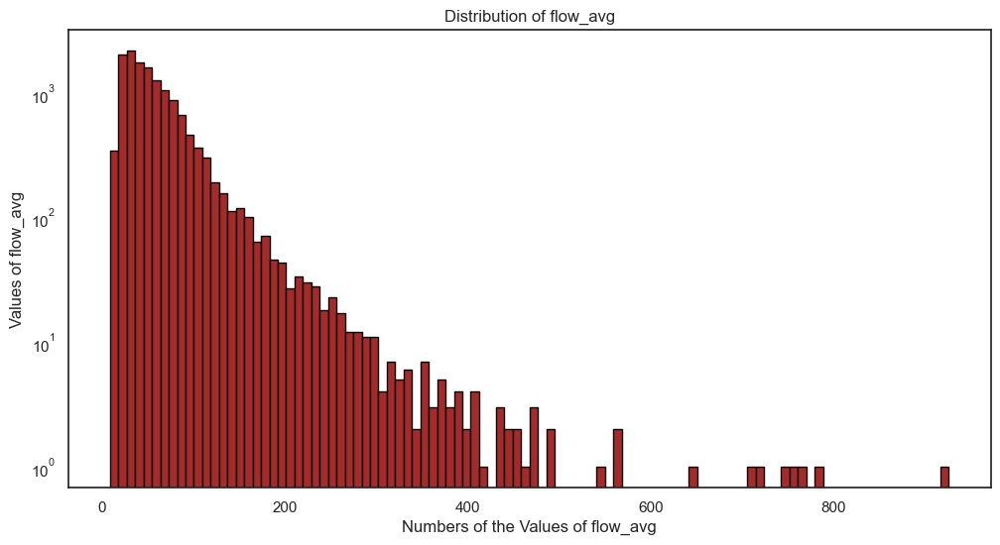

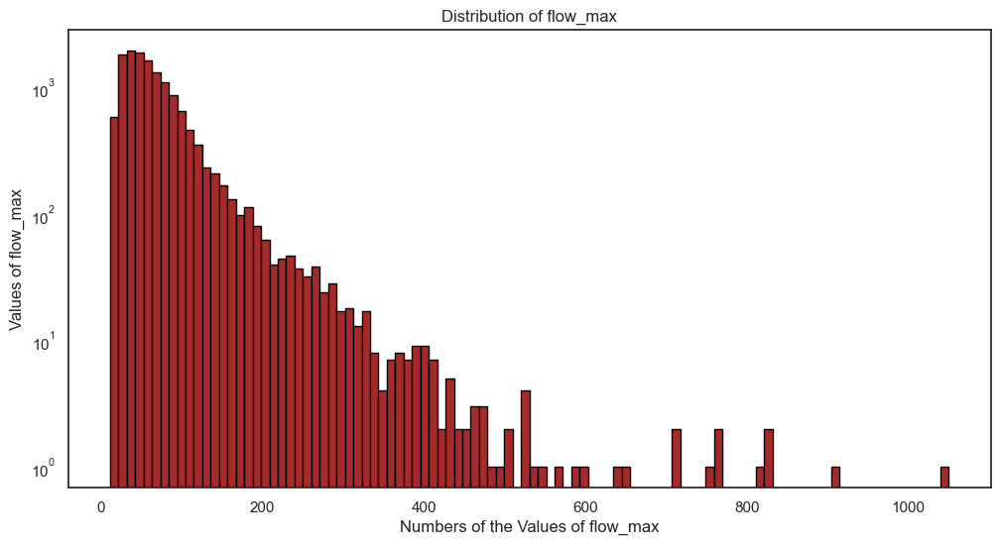

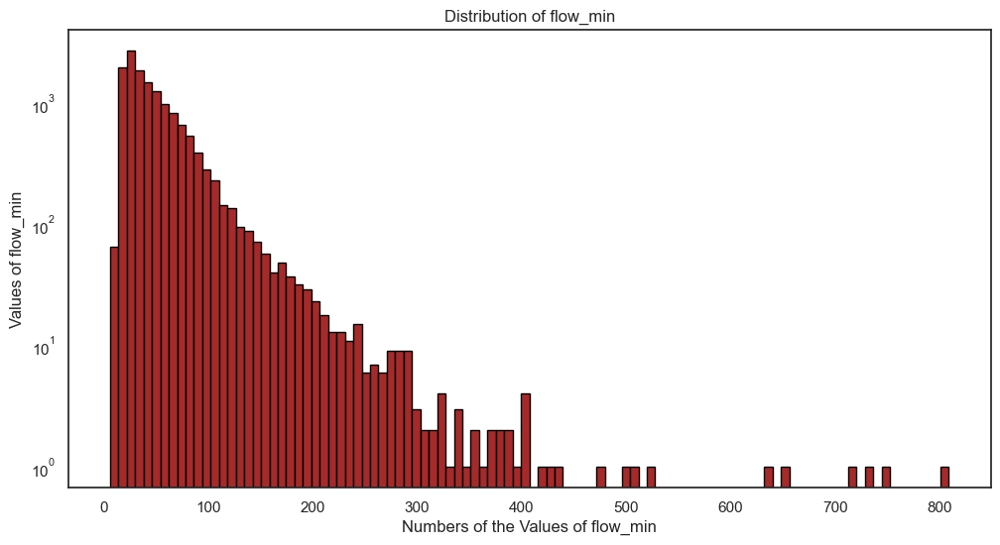

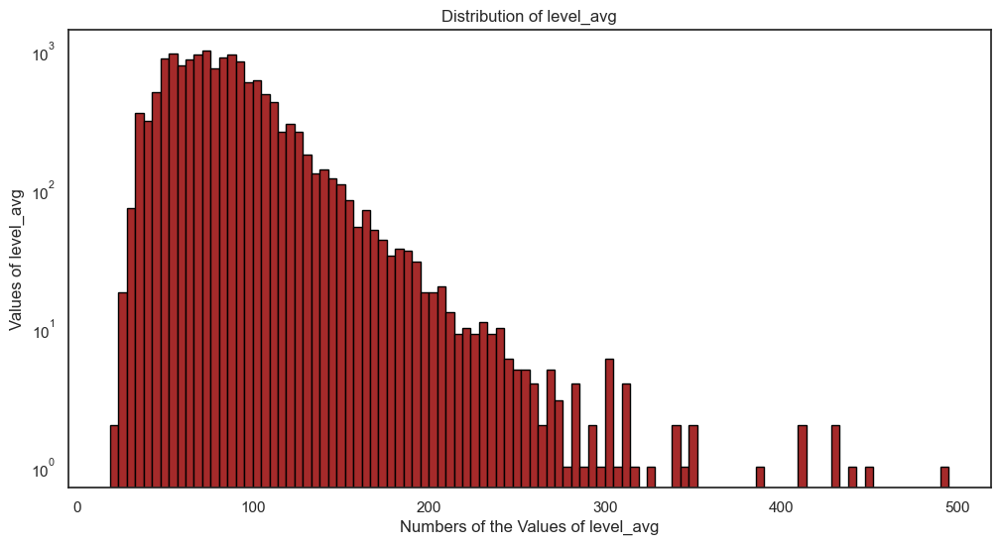

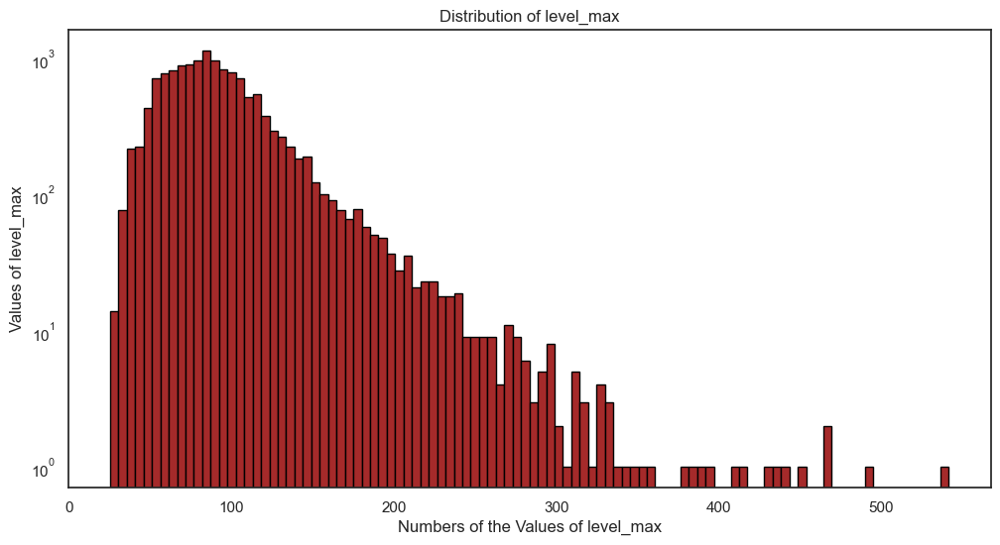

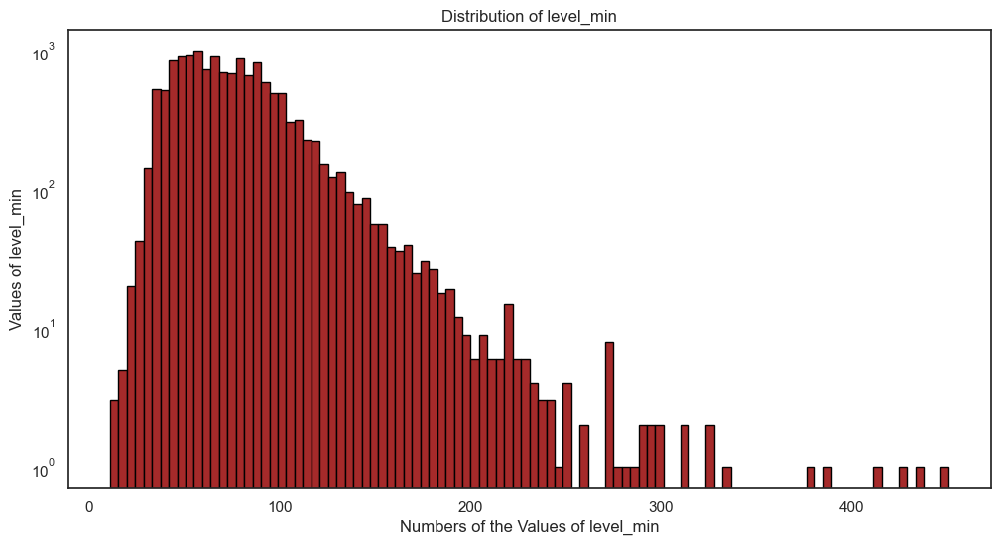

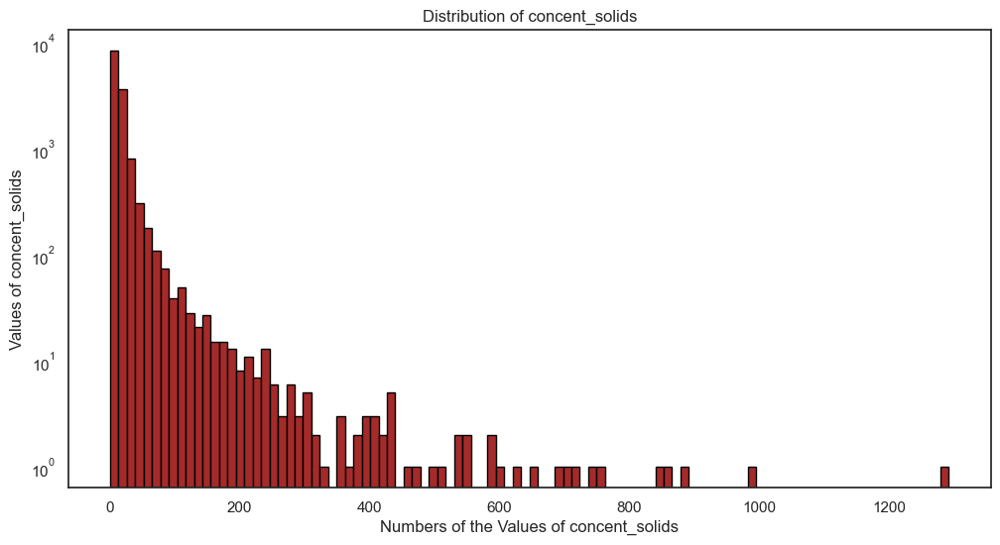

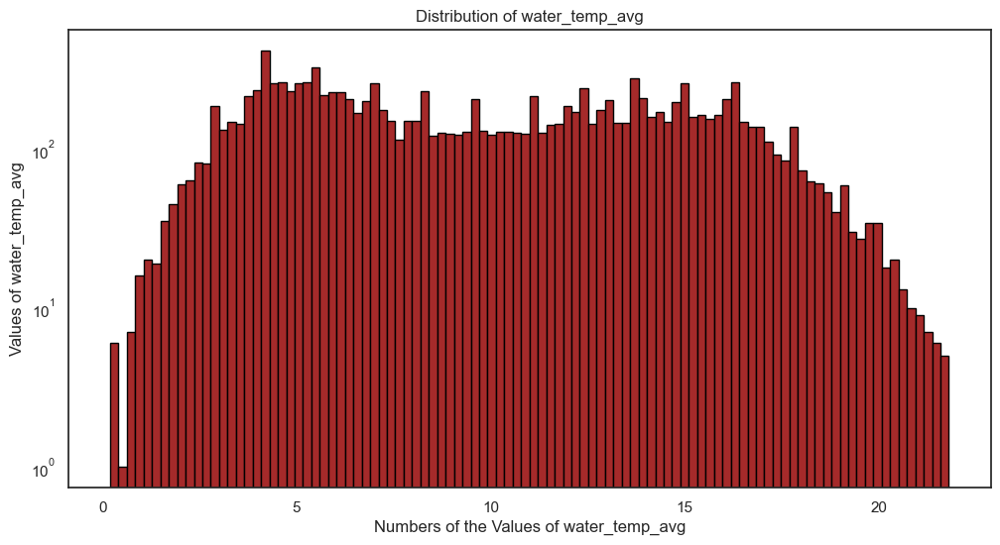

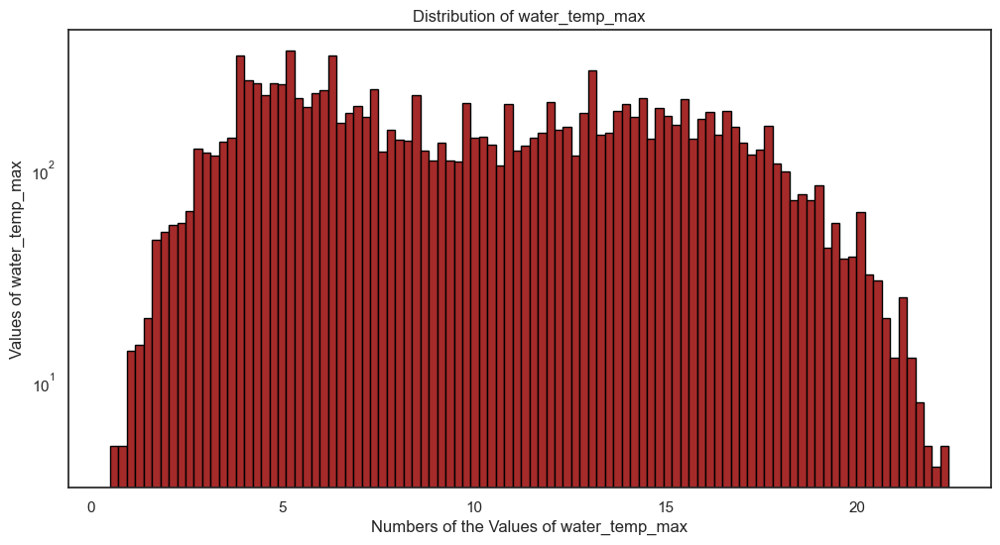

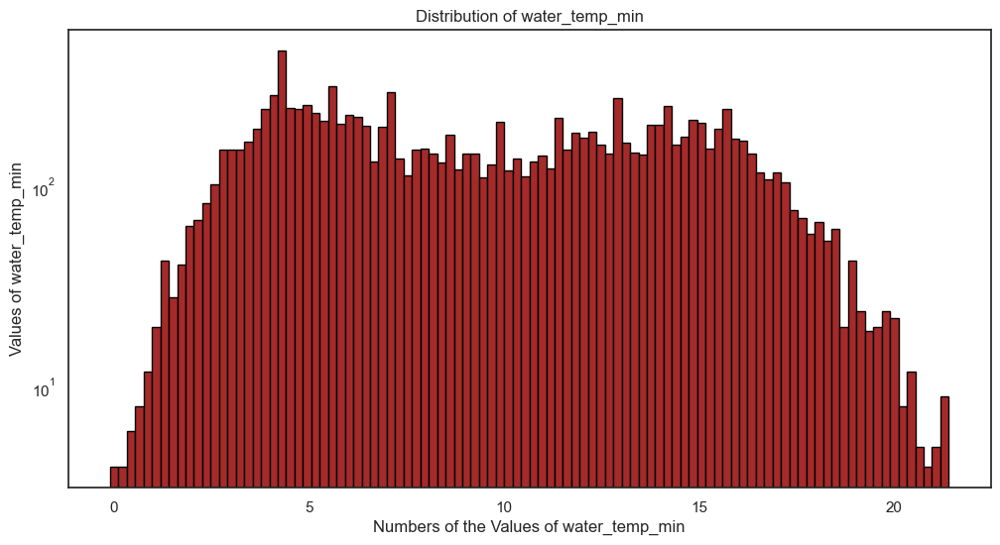

In [27]:
# Plot the distribution of all river variables to decide whether to use the mean or median
for col_name in dict_river_outliers.keys():
    
    plt.figure(figsize=(12,6))
    plt.title(f"Distribution of {col_name}")
    plt.hist(df_river[col_name], bins=100,log=True, edgecolor="black",color='brown')
    plt.xlabel(f"Numbers of the Values of {col_name}")
    plt.ylabel(f"Values of {col_name}")
    plt.show()

<span style="color:#00BFFF;">
    <h3>Distribution Analysis:</h3>
    <p><b>Skewed distributions:</b> Water flow, water level, concentration of suspended solids.</p>
    <p><b>Normally distributed:</b> Water temperature.</p>
    <h3>Conclusion:</h3>
    <p>For skewed variables, the median is a better choice than the mean.</p>
    <p>For normally distributed variables (water temperature), the mean remains a valid option.</p>
</span>

In [28]:
# Get help for diff_medians_outliers function (to understand its parameters)
help(diff_medians_outliers)

Help on function diff_medians_outliers in module Functions_EDA:

diff_medians_outliers(df, col_name, outlier_col)
    Compares the medians of columns with or without outliers.
    Parameters:
    ----------
    df : pd.DataFrame
          The DataFrame containing the data to analyze.
    col_name : str
          The name of the column to investigate.
    outlier_col : str
          The name of the column where outlier flags.
      
    Returns:
    -------
    None
          Prints the medians (with and without outliers) and the percentage difference between them.
    
    Notes:
    -----
    - This function assumes the target column (`col_name`) contains numeric data.
    - The `outlier_col` should flag normal values with 'normal'. Other values are considered outliers.



<h4>Step 3: Comparing Statistical Measures With and Without Outliers</h4>
<p>To determine whether outliers significantly affect the dataset, we compare the statistical measures:</p> 
<ul> 
    <li>For <b>skewed distributions</b> (flow rate, water level, suspended solids): we compare <b>medians</b>.</li> 
    <li>For <b>normally distributed variables</b> (water temperature): we compare <b>means</b>.</li> 
</ul>

In [29]:
# Compare the median for skewed distributions
skewed_variables = ['flow_avg', 'flow_max', 'flow_min', 
                    'level_avg', 'level_max', 'level_min', 
                    'concent_solids']

print("Checking median differences for skewed distributions:")
for col in skewed_variables:
    diff_medians_outliers(df_river, col, f"is_outlier_{col}")

Checking median differences for skewed distributions:
flow_avg:
Median:49.7         
Median without outliers:47.5         
The Difference is: 4.43%         
________________
flow_max:
Median:58.45         
Median without outliers:55.8         
The Difference is: 4.53%         
________________
flow_min:
Median:40.7         
Median without outliers:38.9         
The Difference is: 4.42%         
________________
level_avg:
Median:79.0         
Median without outliers:78.0         
The Difference is: 1.27%         
________________
level_max:
Median:87.0         
Median without outliers:85.0         
The Difference is: 2.3%         
________________
level_min:
Median:71.0         
Median without outliers:70.0         
The Difference is: 1.41%         
________________
concent_solids:
Median:11.0         
Median without outliers:10.19         
The Difference is: 7.36%         
________________


In [30]:
# Compare the mean for normally distributed variables (water temperature)
normal_variables = ['water_temp_avg', 'water_temp_max', 'water_temp_min']

print("\nChecking mean differences for normally distributed variables:")
for col in normal_variables:
    diff_means_outliers(df_river, col, f"is_outlier_{col}")


Checking mean differences for normally distributed variables:
water_temp_avg:
Mean:9.967135039195384         
Mean without outliers:9.967135039195384         
The Difference is: 0.0%         
________________
water_temp_max:
Mean:10.278849282650496         
Mean without outliers:10.278849282650496         
The Difference is: 0.0%         
________________
water_temp_min:
Mean:9.661928708770892         
Mean without outliers:9.661928708770892         
The Difference is: 0.0%         
________________


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>The differences in <b>medians</b> (for skewed distributions) and <b>means</b> (for normally distributed variables) are all below 10%.</p>
    <h3>Conclusion:</h3>
    <p>Outliers do not significantly impact the statistical measures. Therefore, there is no need to remove or replace them in the river data.</p>
</span>

<h3 id="outliersweather"> 4.) Outliers in the Weather Data</h3>

<h4>Step 1: Creating Outlier Columns</h4>
    <p>To systematically analyze outliers, new columns are created for each variable to mark whether a value is considered an outlier.</p>

In [31]:
# Create a dictionary for the weather variables where outliers will be checked

dict_weather_outliers = {col : f"is_outlier_{col}" for col in list_col_weather}
dict_weather_outliers

{'tavg': 'is_outlier_tavg',
 'tmin': 'is_outlier_tmin',
 'tmax': 'is_outlier_tmax',
 'prcp': 'is_outlier_prcp',
 'snow': 'is_outlier_snow',
 'wspd': 'is_outlier_wspd',
 'wpgt': 'is_outlier_wpgt'}

In [32]:
# Create columns for marking outliers and apply the function

for col_name, outlier_col in dict_weather_outliers.items():
    df_weather[outlier_col] = 'normal'
    mark_outliers_IQR(df_weather, col_name, outlier_col, 1.5, True)

tavg:
Lower limit: -14.450000000000003, Upper limit: 34.75
Number of outliers: 5 out of 14236
is_outlier_tavg
normal       14231
suspected        5
Name: count, dtype: int64
_________________________
tmin:
Lower limit: -15.950000000000003, Upper limit: 28.450000000000003
Number of outliers: 13 out of 14236
is_outlier_tmin
normal       14223
suspected       13
Name: count, dtype: int64
_________________________
tmax:
Lower limit: -14.049999999999999, Upper limit: 43.15
Number of outliers: 3 out of 14236
is_outlier_tmax
normal       14233
suspected        3
Name: count, dtype: int64
_________________________
prcp:
Lower limit: -3.9000000000000004, Upper limit: 6.5
Number of outliers: 1814 out of 14236
is_outlier_prcp
normal       12422
suspected     1814
Name: count, dtype: int64
_________________________
snow:
Lower limit: 0.0, Upper limit: 0.0
Number of outliers: 1558 out of 12671
is_outlier_snow
normal       12678
suspected     1558
Name: count, dtype: int64
_________________________


<h4>Step 2: Checking the Distribution of Each Variable</h4>
<p>Before deciding whether the median or mean should be used for comparison, we visualize the distribution of each variable.</p>

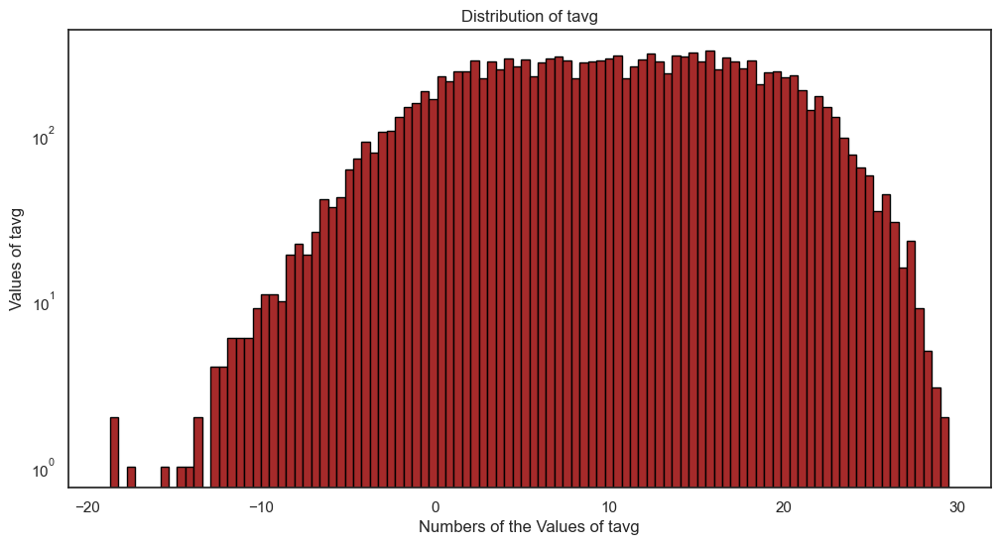

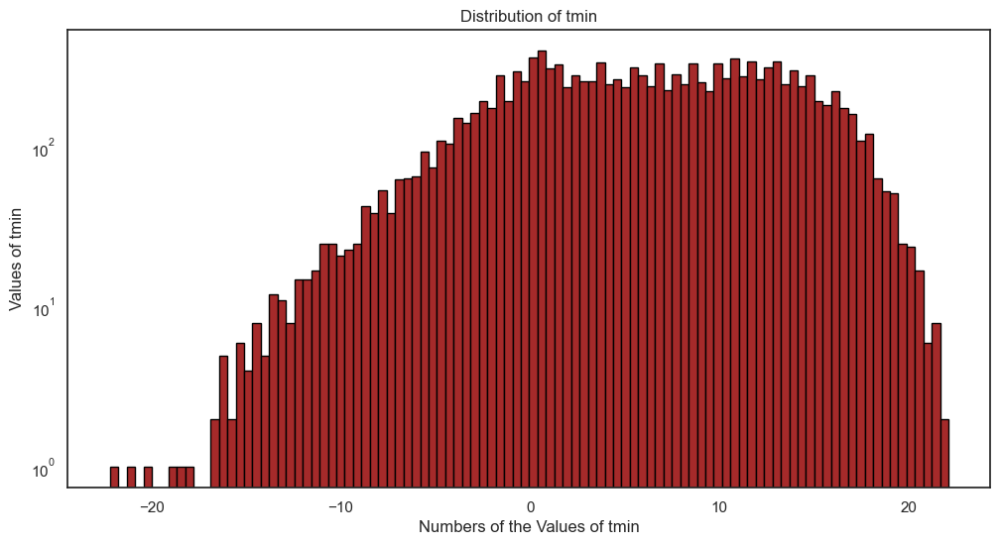

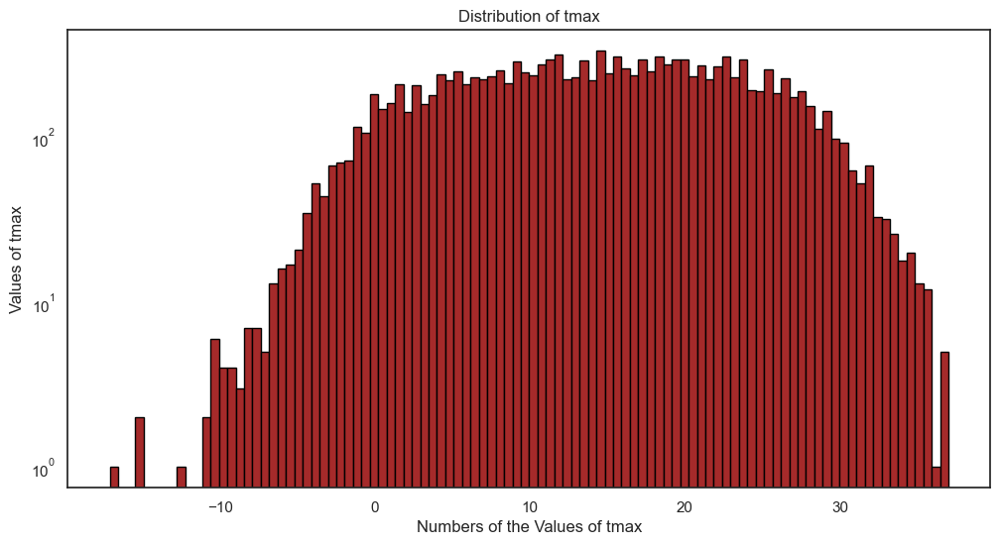

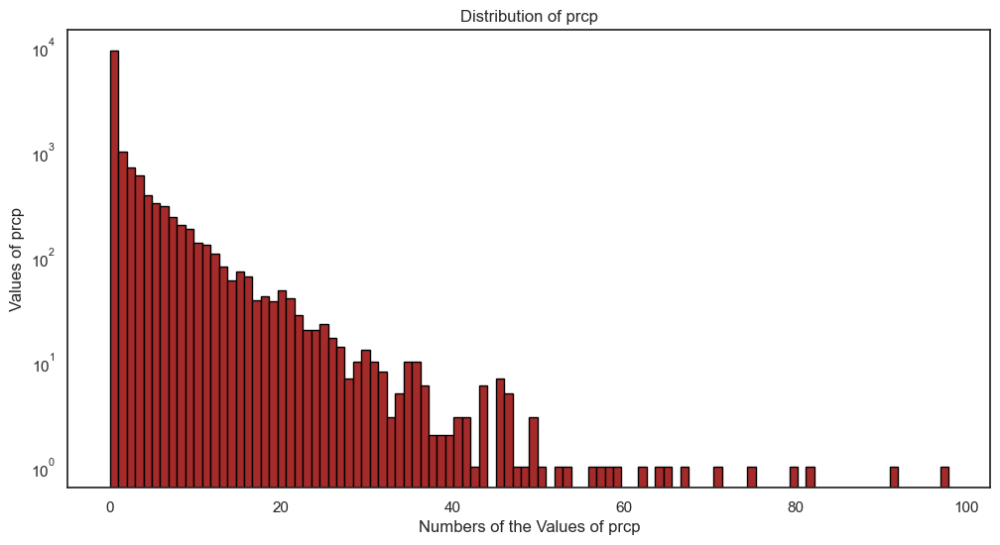

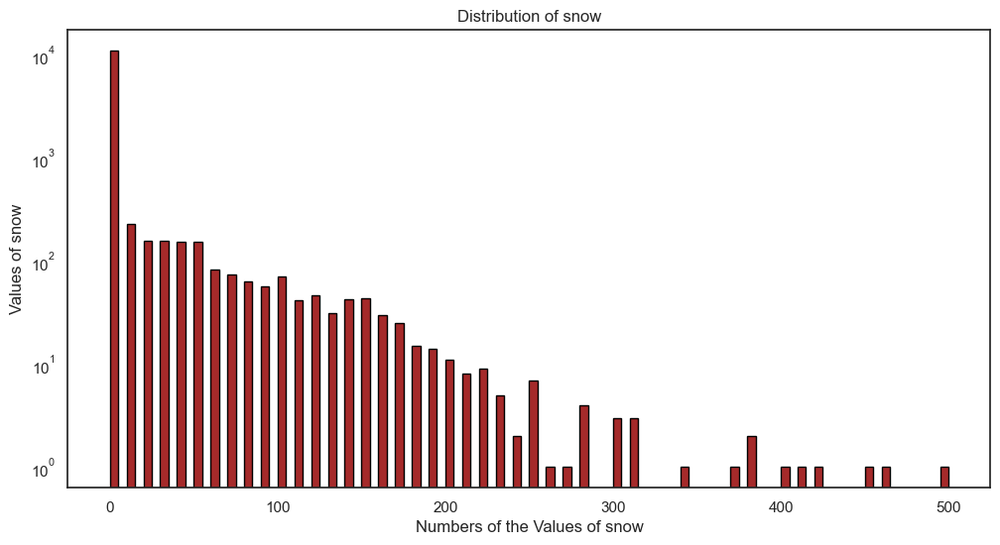

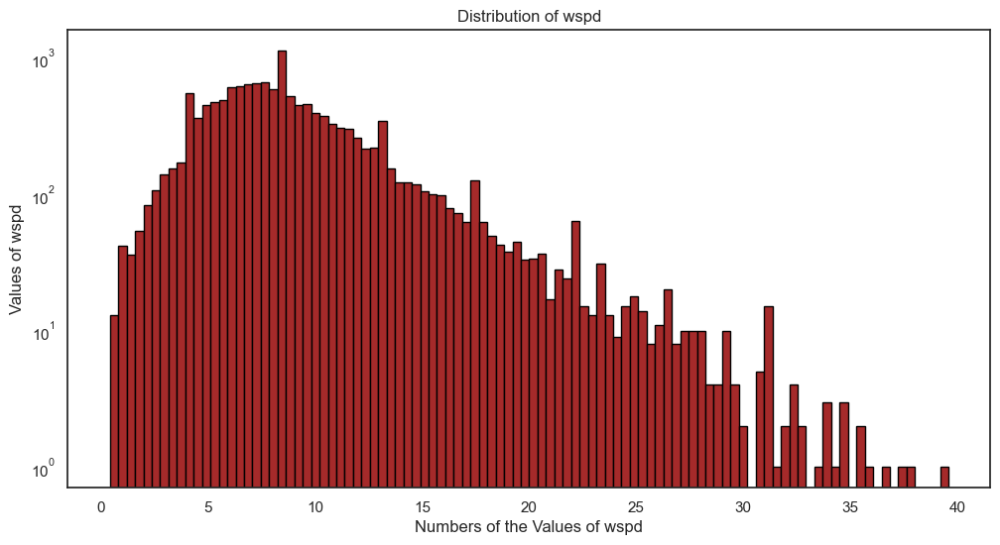

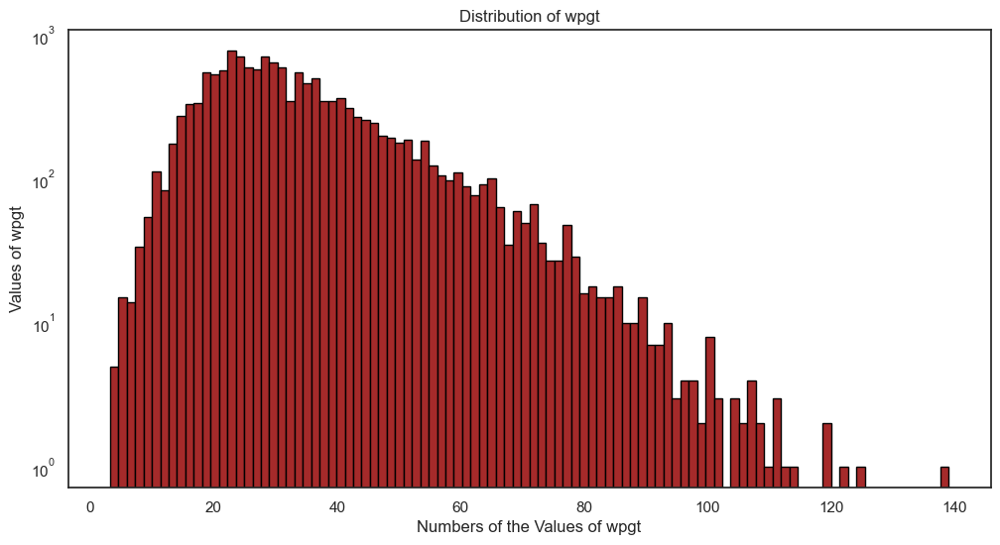

In [33]:
# Plot the distribution of all weather variables to decide whether to use the mean or median
for col_name in dict_weather_outliers.keys():
    
    plt.figure(figsize=(12,6))
    plt.title(f"Distribution of {col_name}")
    plt.hist(df_weather[col_name], bins=100,log=True, edgecolor="black",color='brown')
    plt.xlabel(f"Numbers of the Values of {col_name}")
    plt.ylabel(f"Values of {col_name}")
    plt.show()

<span style="color:#00BFFF;">
    <h3>Distribution Analysis:</h3>
     <p><b>Normally distributed:</b> Air temperature.</p>
    <p><b>Skewed distributions:</b> Precipitation, snow depth, wind speed, wind peak gust.</p>
    <h3>Conclusion:</h3>
    <p>For normally distributed variables (water temperature), the mean remains a valid option.</p>
    <p>For skewed variables, the median is a better choice than the mean.</p>
</span>

<h4>Step 3: Comparing Statistical Measures With and Without Outliers</h4>
<p>To determine whether outliers significantly affect the dataset, we compare the statistical measures:</p> 
<ul> 
    <li>For <b>skewed distributions</b> (flow rate, water level, suspended solids): we compare <b>medians</b>.</li> 
    <li>For <b>normally distributed variables</b> (water temperature): we compare <b>means</b>.</li> 
</ul>

In [34]:
# Compare the mean for normally distributed variables (water temperature)
normal_variables = ['tavg', 'tmax', 'tmin']

print("\nChecking mean differences for normally distributed variables:")
for col in normal_variables:
    diff_means_outliers(df_weather, col, f"is_outlier_{col}")


Checking mean differences for normally distributed variables:
tavg:
Mean:10.110002809778027         
Mean without outliers:10.11950671070199         
The Difference is: -0.09%         
________________
tmax:
Mean:14.49376931722394         
Mean without outliers:14.500168622215977         
The Difference is: -0.04%         
________________
tmin:
Mean:6.108162405169991         
Mean without outliers:6.1301413203965405         
The Difference is: -0.36%         
________________


In [35]:
# Compare the median for skewed distributions
skewed_variables = ['prcp', 'snow', 'wspd', 'wpgt']

print("Checking median differences for skewed distributions:")
for col in skewed_variables:
    diff_medians_outliers(df_weather, col, f"is_outlier_{col}")

Checking median differences for skewed distributions:
prcp:
Median:0.0         
Median without outliers:0.0         
The Difference is: nan%         
________________
snow:
Median:0.0         
Median without outliers:0.0         
The Difference is: nan%         
________________
wspd:
Median:8.3         
Median without outliers:7.9         
The Difference is: 4.82%         
________________
wpgt:
Median:30.6         
Median without outliers:29.9         
The Difference is: 2.29%         
________________


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>The differences in <b>means</b> for <b>air temperature (average, minimum, and maximum)</b>, 
    and the <b>medians</b> in <b>windspeed and wind peak gust</b> are less than 10%.</p>
    <p>For <b>precipitation and snow depth</b>, the median comparison could not be calculated (NaN result, likely due to division by zero).</p>
    <h3>Conclusion:</h3>
    <p>Outliers in air temperature (avg, min, max), windspeed, and wind peak gust <b>do not need to be replaced</b>.<br>
    Further analysis is required for precipitation and snow depth.</p>
</span>


<h3 id='prcpOutliers'>3.1 Outliers in Precipitation:</h3>

<h3 id='approachPrcpSnow'>Approach for Precipitation</h3>

<p>The main challenge is that the median/mean comparison fails due to a high number of zero values.</p>

<h4>Steps:</h4>
<ol>
    <li>Exclude zero values for a meaningful median/mean comparison.</li>
    <li>Recalculate the median and mean.</li>
    <li>Check whether outliers significantly impact statistical values.</li>
</ol>


In [36]:
# Checking the total number of values, zeros, and NaNs

print(f"PRECIPITATION\
      \nTotal numbers of values:\
      \n{df_weather['prcp'].count()}\
      \n_________________________\
      \nZeros:\
      \n{df_weather[df_weather['prcp'] == 0]['prcp'].count()}\
      \n_________________________\
      \nMissing values:\
      \n{df_weather['prcp'].isna().sum()}\
      \n_________________________\
      \nDifference (total - missing values and zeros):\
      \n{df_weather[['prcp']].count() - df_weather[(df_weather['prcp'] == 0) | (df_weather['prcp'].isna())][['prcp']].count()}\
      \n_________________________\
      \nMedian:{df_weather['prcp'].median()}")

PRECIPITATION      
Total numbers of values:      
14236      
_________________________      
Zeros:      
7137      
_________________________      
Missing values:      
0      
_________________________      
Difference (total - missing values and zeros):      
prcp    7099
dtype: int64      
_________________________      
Median:0.0


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>There are <b>7,137 zero values</b> in precipitation out of <b>14,236 total values</b>.</p>
    <p>The median of precipitation is <b>0.0</b>, making direct median/mean comparisons impossible.</p>
    <h3>Conclusion:</h3>
    <p>To analyze outliers, we first exclude zero values.</p>
</span>

In [37]:
# Create a new DataFrame without the zeros
df_prcp_no_zeros = df_weather[df_weather['prcp'] != 0]

In [38]:
# Mark outliers in precipitation data (excluding zeros)
df_prcp_no_zeros['is_outlier_prcp'] = 'normal'
mark_outliers_IQR(df_prcp_no_zeros, 'prcp', 'is_outlier_prcp', 1.5, True)

prcp:
Lower limit: -8.3, Upper limit: 15.7
Number of outliers: 522 out of 7099
is_outlier_prcp
normal       6577
suspected     522
Name: count, dtype: int64
_________________________


In [39]:
# Compare the medians with and without outliers
diff_medians_outliers(df_prcp_no_zeros, 'prcp', 'is_outlier_prcp')

prcp:
Median:2.6         
Median without outliers:2.3         
The Difference is: 11.54%         
________________


<h3>Extra Step: Checking Absolute Differences in Precipitation</h3>

<p>The difference between the median values with and without outliers exceeds the <b>10% threshold</b>.  
However, a relative percentage alone does not always indicate a significant impact.  
To make a well-founded decision, we now analyze the <b>absolute difference in precipitation (in mm).</b></p>

<h4>Approach:</h4>
<ol>
    <li>Calculate the <b>absolute difference</b> in the medians.</li>
    <li>Compare this value to typical precipitation levels:</li>
    <ul>
        <li>How does the absolute difference compare to the mean precipitation?</li>
        <li>How does it compare to the maximum recorded precipitation?</li>
        <li>How does it compare to the standard deviation?</li>
    </ul>
    <li>Decide whether this difference is <b>statistically relevant</b> or negligible.</li>
</ol>

<p><b>Conclusion:</b> If the absolute difference is <b>small in comparison to the overall distribution</b>, outliers may not need to be removed or replaced.</p>

In [40]:
# Calculate absolute difference
absolute_diff = df_prcp_no_zeros['prcp'].median() - df_prcp_no_zeros[df_prcp_no_zeros['is_outlier_prcp'] != 'suspected']['prcp'].median()
print(f"Absolute difference in median: {absolute_diff:.2f} mm")

Absolute difference in median: 0.30 mm


In [41]:
# Check full statistics for precipitation (without zeros)
df_prcp_no_zeros['prcp'].describe()

count    7099.000000
mean        5.204705
std         7.326174
min         0.100000
25%         0.700000
50%         2.600000
75%         6.700000
max        97.900000
Name: prcp, dtype: float64

<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>There are <b>7,137 zero values</b> in precipitation out of <b>14,236 total values</b>.</p>
    <p>After excluding zero values, <b>522 outliers</b> remain.</p>
    <p>The difference in median (with and without outliers) is <b>0.3 mm</b>, which is very small.</p>
    <h3>Statistical Overview:</h3>
    <ul>
        <li><b>Mean:</b> 5.20 mm</li>
        <li><b>Standard deviation:</b> 7.33 mm</li>
        <li><b>Minimum:</b> 0.1 mm</li>
        <li><b>25%-Quantile:</b> 0.7 mm</li>
        <li><b>Median:</b> 2.6 mm</li>
        <li><b>75%-Quantile:</b> 6.7 mm</li>
        <li><b>Maximum:</b> 97.9 mm</li>
    </ul>
    <h3>Conclusion:</h3>
    <p>The outliers do not significantly impact the statistical values.<br>
    The absolute median difference is only 0.3 mm, which is just <b>0.3% of the maximum precipitation</b> (97.9 mm) and <b>5.8% of the mean</b> (5.20 mm).<br>
    Given the standard deviation (7.33 mm), this difference is statistically irrelevant.</p>  
    <p><b>Final Decision:</b> Outliers in precipitation <b>do not need to be removed or replaced.</b></p>
</span>

<h3 id='snowOutliers'>3.2 Outliers in Snow Depth</h3>

<h4>Approach for Snow Depth</h4>
<p>Unlike precipitation, snow depth contains two major data issues:</p>
<ul>
    <li><b>Unrealistically high values</b> (up to 500 cm) – such extreme snow depths are not realistic for Munich.</li>
    <li><b>A high number of zero values</b> (11,113 out of 12,671) – making direct median comparisons meaningless.</li>
</ul>

<h4>Steps:</h4>
<ol>
    <li>Replace <b>unrealistic values above 150 cm</b> using time-based interpolation.</li>
    <li>Exclude <b>zero values</b> to ensure meaningful median comparisons.<br>
    <i>Reason:</i> The large number of zero values distorts statistical measures, making it impossible to determine the true impact of outliers.</li>
    <li>Perform <b>outlier detection</b> (IQR method) on the cleaned data.</li>
    <li>Compare medians with and without outliers.</li>
    <li>Decide based on the results whether outliers need to be removed or retained.</li>
</ol>

<p><b>This approach ensures that extreme values do not distort the analysis and that statistical comparisons remain valid.</b></p>

In [42]:
# Replace all values of snow higher than 150cm with interpolated values

# Set the date column as index before interpolation
df_weather['date_interpolate'] = df_weather['date']
df_weather.set_index('date_interpolate', inplace=True)

# create a new column to store original snow depth values for tracking changes
snow_original = np.nan

# Identify all values greater than 150 cm
mask = df_weather['snow'] > 150

# Count the number of values over 150 cm before replacement (for validation)
count_over_150 = df_weather[mask]['snow'].shape[0]

# Replace outliers with NaN before interpolation
df_weather.loc[mask, 'snow_original'] = df_weather['snow']  # Store original values
df_weather.loc[mask, 'snow'] = np.nan

# Apply time-based interpolation
df_weather['snow'] = df_weather['snow'].interpolate(method='time')

# Mark interpolated values
df_weather.loc[mask, 'is_outlier_snow'] = 'interpolated_value_time'

# Count the number of successfully interpolated values
count_filled_in = df_weather[df_weather['is_outlier_snow'] == 'interpolated_value_time']['snow'].shape[0]

# Print the result to verify procedure:
print(f"Number of values with snow depth > 150cm before replacement: {count_over_150}")
print(f"Number of interpolated values: {count_filled_in}")

Number of values with snow depth > 150cm before replacement: 148
Number of interpolated values: 148


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p><b>148 values</b> in snow depth were replaced with interpolated values.</p>
    <p>This ensures a more realistic representation of snow depth measurements.</p>
    <h3>Next steps:</h3>
    <p>zero values will be excluded to enable meaningful median comparisons.</p>
</span>

In [43]:
# Checking the total number of values, zeros, and NaNs

print(f"SNOW DEPTH\
      \nTotal numbers of values:\
      \n{df_weather['snow'].count()}\
      \n_________________________\
      \nZeros:\
      \n{df_weather[df_weather['snow'] == 0]['snow'].count()}\
      \n_________________________\
      \nMissing values:\
      \n{df_weather['snow'].isna().sum()}\
      \n_________________________\
      \nDifference (total - missing values and zeros):\
      \n{df_weather[['snow']].count() - df_weather[(df_weather['prcp'] == 0) | (df_weather['snow'].isna())][['snow']].count()}\
      \n_________________________\
      \nMedian:{df_weather['snow'].median()}")

SNOW DEPTH      
Total numbers of values:      
14236      
_________________________      
Zeros:      
12183      
_________________________      
Missing values:      
0      
_________________________      
Difference (total - missing values and zeros):      
snow    7099
dtype: int64      
_________________________      
Median:0.0


<span style='color:#00BFFF;'>
    <h3>Results:</h3>
    <p>There are <b>12,183 zero values</b> in snow depth out of <b>14,236 total values</b>.</p>
    <p>The median of snow depth is <b>0.0</b>, making direct median/mean comparisons impossible.</p>
    <h3>Conclusion:</h3>
    <p>To analyze outliers, we first exclude zero values.</p>
</span>

In [44]:
# Create a new DataFrame without the zeros
df_snow_no_zeros = df_weather[df_weather['snow'] != 0]

# Set the column to mark the outliers to 'normal'
df_snow_no_zeros['is_outlier_snow'] = 'normal'

# Mark outliers 
mark_outliers_IQR(df_snow_no_zeros, 'snow', 'is_outlier_snow', 1.5, True)

snow:
Lower limit: -81.44578313253012, Upper limit: 176.86746987951807
Number of outliers: 0 out of 2053
is_outlier_snow
normal    2053
Name: count, dtype: int64
_________________________


<span style='color:#00BFFF;'>
    <h3>Result</h3>
    <p>After removing unrealistic values and excluding zeros, no outliers remain in the dataset.  
    Therefore, no further action is required.</p>
</span>

<h2 id="duplicates">B.) Removing Duplicates</h2>

<h3>Approach:</h3>

<p>To ensure accuracy, duplicates will be checked within the individual DataFrames of the river variables before merging.  
This prevents inconsistencies that could arise from merging data with duplicated entries.  
To detect duplicates efficiently, a function will be used that compares the number of entries before and after dropping duplicates.</p>

In [45]:
# Function for dropping and checking the duplicates of all DataFrames 

def dropping_dupllicates_list(dict_dataframes_names):
    for name, df in dict_dataframes_names.items():
        
        print("\Differences in the dataframes before and after dropping duplicates: ",
              "\n", name,
              "\Differences in Data: ", 
              "\n", (df.count()-df.drop_duplicates().count()),
              "\n---------------------------------")

In [46]:
# Create a dictionary with all DataFrames and their names for looping through them
dataframes_names = {'water level' : df_level, 
                    'flow rate' : df_flow_rate,
                    'water temperature' : df_water_temp,
                    'concentration of suspended solids' : df_concent_solids,
                    'weather' : df_weather}

# Apply the function to check for duplicates
dropping_dupllicates_list(dataframes_names)

\Differences in the dataframes before and after dropping duplicates:  
 water level \Differences in Data:  
 date         0
level_avg    0
level_max    0
level_min    0
dtype: int64 
---------------------------------
\Differences in the dataframes before and after dropping duplicates:  
 flow rate \Differences in Data:  
 date        0
flow_avg    0
flow_max    0
flow_min    0
dtype: int64 
---------------------------------
\Differences in the dataframes before and after dropping duplicates:  
 water temperature \Differences in Data:  
 date              0
water_temp_avg    0
water_temp_max    0
water_temp_min    0
dtype: int64 
---------------------------------
\Differences in the dataframes before and after dropping duplicates:  
 concentration of suspended solids \Differences in Data:  
 date              0
concent_solids    0
dtype: int64 
---------------------------------
\Differences in the dataframes before and after dropping duplicates:  
 weather \Differences in Data:  
 date 

<span style='color:#00BFFF;'>
    <h3>Result:</h3>
    <p>No duplicates were found in any of the datasets.  
    Therefore, no further action is required.</p>
</span>

<h2 id="nans">B.) Handling Missing Values</h2>
<h3 id="nansapproach">1. Approach:</h3>

<ol>
    <li>Merge river and weather data into a single dataset, making sure the timestamps match and the data lines up correctly.</li>
    <li>Verify that the DataFrame is complete and no day is missing, as each row represents a single day.</li>
    <li>Analyze missing values for each variable to detect patterns and periods with higher NaN occurrences.</li>
    <li>Choose the most suitable imputation method for each variable to maintain data integrity.</li>
    <li>Validate the imputed values by comparing trends before and after filling to detect potential biases or distortions.</li>
</ol>

### Initial Check: Identifying Missing Values and Data Structure

<p>Before merging, I check the structure of both DataFrames to ensure:</p>

<ul>
    <li>All expected columns are present.</li>
    <li>The correct data types are used.</li>
    <li>The number of missing values per column.</li>
</ul>

In [47]:
df_river.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14244 entries, 9558 to 23801
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   date                       14244 non-null  datetime64[ns]
 1   flow_avg                   14244 non-null  float64       
 2   flow_max                   14244 non-null  float64       
 3   flow_min                   14244 non-null  float64       
 4   level_avg                  14244 non-null  float64       
 5   level_max                  14244 non-null  float64       
 6   level_min                  14244 non-null  float64       
 7   concent_solids             14014 non-null  float64       
 8   water_temp_avg             13522 non-null  float64       
 9   water_temp_max             13522 non-null  float64       
 10  water_temp_min             13522 non-null  float64       
 11  year                       14244 non-null  int32         
 12  month 

In [48]:
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 14236 entries, 1985-01-01 to 2023-12-31
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   date             14236 non-null  datetime64[ns]
 1   tavg             14236 non-null  float64       
 2   tmin             14236 non-null  float64       
 3   tmax             14236 non-null  float64       
 4   prcp             14236 non-null  float64       
 5   snow             14236 non-null  float64       
 6   wspd             14167 non-null  float64       
 7   wpgt             14152 non-null  float64       
 8   year             14236 non-null  int32         
 9   month            14236 non-null  int32         
 10  is_outlier_tavg  14236 non-null  object        
 11  is_outlier_tmin  14236 non-null  object        
 12  is_outlier_tmax  14236 non-null  object        
 13  is_outlier_prcp  14236 non-null  object        
 14  is_outlier_snow  1423

<h3 id="nansmerge">2. Merging River and Weather Data</h3>

<p>To ensure a complete dataset, the river and weather data are merged using an <strong>outer join</strong>.  
This approach keeps all available data from both sources, even if some dates are missing in one of the DataFrames.<br>
Since each row represents a single day, it is crucial that timestamps match correctly.  
Any missing dates will be addressed in the next step.<br>
Some columns exist in both datasets, so suffixes <code>_river</code> and <code>_weather</code>  
are added to differentiate them. Any redundant columns will be removed later.</p>

In [49]:
# Merging the river and weather data using an outer join
df_river_weather = pd.merge(df_river, df_weather, how='outer', on='date', suffixes=('_river', '_weather'))

In [50]:
# Checking, if the merged DataFrame is complete:
df_river_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14244 entries, 0 to 14243
Data columns (total 40 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   date                       14244 non-null  datetime64[ns]
 1   flow_avg                   14244 non-null  float64       
 2   flow_max                   14244 non-null  float64       
 3   flow_min                   14244 non-null  float64       
 4   level_avg                  14244 non-null  float64       
 5   level_max                  14244 non-null  float64       
 6   level_min                  14244 non-null  float64       
 7   concent_solids             14014 non-null  float64       
 8   water_temp_avg             13522 non-null  float64       
 9   water_temp_max             13522 non-null  float64       
 10  water_temp_min             13522 non-null  float64       
 11  year_river                 14244 non-null  int32         
 12  mont

In [51]:
# Dropping redundant columns:
redundant_cols = ['year_weather', 'month_weather']
df_river_weather = df_river_weather.drop(columns=redundant_cols)

# Checking the DataFrame after dropping the columns
df_river_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14244 entries, 0 to 14243
Data columns (total 38 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   date                       14244 non-null  datetime64[ns]
 1   flow_avg                   14244 non-null  float64       
 2   flow_max                   14244 non-null  float64       
 3   flow_min                   14244 non-null  float64       
 4   level_avg                  14244 non-null  float64       
 5   level_max                  14244 non-null  float64       
 6   level_min                  14244 non-null  float64       
 7   concent_solids             14014 non-null  float64       
 8   water_temp_avg             13522 non-null  float64       
 9   water_temp_max             13522 non-null  float64       
 10  water_temp_min             13522 non-null  float64       
 11  year_river                 14244 non-null  int32         
 12  mont

In [52]:
# renaming 'year_river' and 'month_river' for consistency
df_river_weather = df_river_weather.rename(columns=
                        {'year_river' : 'year',
                         'month_river' : 'month'})

# Final check of the cleaned DataFrame structure
df_river_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14244 entries, 0 to 14243
Data columns (total 38 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   date                       14244 non-null  datetime64[ns]
 1   flow_avg                   14244 non-null  float64       
 2   flow_max                   14244 non-null  float64       
 3   flow_min                   14244 non-null  float64       
 4   level_avg                  14244 non-null  float64       
 5   level_max                  14244 non-null  float64       
 6   level_min                  14244 non-null  float64       
 7   concent_solids             14014 non-null  float64       
 8   water_temp_avg             13522 non-null  float64       
 9   water_temp_max             13522 non-null  float64       
 10  water_temp_min             13522 non-null  float64       
 11  year                       14244 non-null  int32         
 12  mont

<h3 id="checkcomplete">3. Checking DataFrame Completeness</h3>
<p>Before analyzing missing values, I verify that the dataset covers the entire timeframe (1985-2023) with no missing days.</p> 
<ol>
    <h4>Steps:</h4>
    <ol>
    <li>Generate a complete <code>DatetimeIndex</code> from January 1, 1985, to December 31, 2023.</li>
    <li>Convert both the expected date range and the DataFrame's <code>'date'</code> column into sets.</li>
    <li>Compare these sets to detect any missing dates.</li>
    <li>Check for duplicate entries in the <code>'date'</code> column.</li>
</ol>

In [53]:
# Creating a DatetimeIndex for the expected timeframe
pd.date_range(start='1985-01-01', end='2023-12-31', freq='D')

DatetimeIndex(['1985-01-01', '1985-01-02', '1985-01-03', '1985-01-04',
               '1985-01-05', '1985-01-06', '1985-01-07', '1985-01-08',
               '1985-01-09', '1985-01-10',
               ...
               '2023-12-22', '2023-12-23', '2023-12-24', '2023-12-25',
               '2023-12-26', '2023-12-27', '2023-12-28', '2023-12-29',
               '2023-12-30', '2023-12-31'],
              dtype='datetime64[ns]', length=14244, freq='D')

In [54]:
# Create a complete DatetimeIndex for the expected timeframe
set_dateTimeIndex = set(pd.date_range(start='1985-01-01', end='2023-12-31', freq='D'))

# Convert the existing 'date' column to a set
set_date_river_weather = set(df_river_weather['date'])

# Identify missing days by calculating the difference between the sets
missing_days = set_dateTimeIndex - set_date_river_weather

# Display the missing dates (if any)
missing_days

set()

In [55]:
# Check for duplicate date entries
df_river_weather[df_river_weather['date'].duplicated()]

,date,flow_avg,flow_max,flow_min,level_avg,level_max,level_min,concent_solids,water_temp_avg,water_temp_max,...,wspd,wpgt,is_outlier_tavg,is_outlier_tmin,is_outlier_tmax,is_outlier_prcp,is_outlier_snow,is_outlier_wspd,is_outlier_wpgt,snow_original


<span style="color:##00BFFF;">
    <b>Result:</b><br>
    The <code>missing_days</code> set is empty, meaning that no dates are missing in the timeframe (1985–2023).<br>
    Additionally, no duplicate entries were found in the <code>'date'</code> column.<br><br>
    <b>Conclusion:</b> The DataFrame <code>df_river_weather</code> provides a complete and unique daily record for the given timeframe.<br><br>
    <b>Next step:</b> Analyze the distribution of NaN values to determine the most appropriate imputation methods.
</span>


<h3 id="nansanalysis">4. Analyze the Missing Values in Each Variable</h3> 

In [56]:
# Checking the numbers of NaNs in each variable:
df_river_weather.isna().sum()

date                             0
flow_avg                         0
flow_max                         0
flow_min                         0
level_avg                        0
level_max                        0
level_min                        0
concent_solids                 230
water_temp_avg                 722
water_temp_max                 722
water_temp_min                 722
year                             0
month                            0
is_outlier_flow_avg              0
is_outlier_flow_max              0
is_outlier_flow_min              0
is_outlier_level_avg             0
is_outlier_level_max             0
is_outlier_level_min             0
is_outlier_concent_solids        0
is_outlier_water_temp_avg        0
is_outlier_water_temp_max        0
is_outlier_water_temp_min        0
tavg                             8
tmin                             8
tmax                             8
prcp                             8
snow                             8
wspd                

<span style="color:#00BFFF;">
    <b>Result:</b><br>
    <h3>No missing values in:</h3>
    <ol>
        <li>Water flow (all variables)</li>
        <li>Water level (all variables)</li>
    </ol>
    <h3>Missing values found in:</h3>
    <ul>
        <li><code>concent_solids:</code> 230</li>
        <li><code>water_temp_avg:</code> 722</li>
        <li><code>water_temp_max:</code> 722</li>
        <li><code>water_temp_min:</code> 722</li>
        <li><code>tavg:</code> 8</li>
        <li><code>tmin:</code> 8</li>
        <li><code>tmax:</code> 8</li>
        <li><code>snow:</code> 1573</li>
        <li><code>wspd:</code> 77</li>
        <li><code>wpgt:</code> 92</li>
    </ul>

<h3>Next Steps:</h3>
<ol>
    <li>Prioritize: <b>snow</b>, then <b>water temperature</b>, <b>concent_solids</b>, <b>wind speed</b>, and <b>precipitation & air temperature</b>.</li>
    <li>Analyze seasonal patterns of missing values.</li>
</ol>


<p>In the column <code>snow</code> there need to be a special handling, because like I already discoverd in the section of Handling outliers there is a mix between NaNs and '0'. Especially in summer months, when there isn't any snow in Munich.<br>
Following steps are made with the column <code>'snow'</code>.</p>
    <ol>
        <li>Looking into the all over sum of the snow depth to identify, when there is absolutely now snow in Munich</li>
        <li>Checking if there are zeros in summertime</li>
        <li>Checking if there are NaNs in summertime</li>
        <li>Deciding what to do with missing values in summertime, if they should be filled in with zeros or be ignored (defining masks e.g. in analyses)</li>
    </ol>

### Step 1: Investigating the Seasonal Pattern of Snow Depth

In [57]:
# Checking the total sum of snow depth per month
snow_per_month = df_river_weather.groupby(df_river_weather['month'])['snow'].sum()
snow_per_month

month
1     28912.018072
2     30086.125506
3     12600.554656
4      1589.188983
5       441.095882
6       499.765865
7       591.753573
8       668.317318
9       719.657578
10     1007.396062
11     8031.265060
12    18657.861446
Name: snow, dtype: float64

In [58]:
# Checking the number of NaNs in 'snow' per month
df_river_weather['snow'].isna().groupby(df_river_weather['month']).sum()

month
1     4
2     0
3     0
4     0
5     0
6     0
7     0
8     0
9     0
10    0
11    0
12    4
Name: snow, dtype: int64

In [59]:
# Checking, if there are zeros in the summer months
df_river_weather[df_river_weather['snow'] == 0].groupby(df_river_weather['month'])['snow'].count()

month
1      710
2      672
3      998
4     1107
5     1147
6     1110
7     1147
8     1147
9     1110
10    1170
11    1008
12     857
Name: snow, dtype: int64

<span style="color:#00BFFF;">
    <b>Result:</b> - A mix of <b>NaNs and zeros</b> exists in the <code>snow</code> column.<br>
    - During summer months <b>(May to September)</b>, snow is <b>absent</b>.<br><br>
    <b>Next steps:</b>
    <ol>
        <li>Replace NaNs in the <code>snow</code> column with 0 for the months <b>May to September</b>.</li>
        <li>Analyze patterns the pattern of remaining NaNs.</li>
    </ol>
</span>

### Step 2: Replacing NaNs in Summer (May to September) with Zero

In [60]:
# create a mask for NaNs in snow during summer (May to September)
mask_snow_summer = (df_river_weather['snow'].isna()) & (df_river_weather['month'] >= 5) & (df_river_weather['month'] <= 9)

# Checking how many values match the condition
df_river_weather[mask_snow_summer][['snow', 'month']].groupby(df_river_weather['month']).count()

,snow,month
month,,


In [61]:
# Replace the NaNs with 0
df_river_weather.loc[mask_snow_summer, 'snow'] = 0

In [62]:
# Verify that all NaNs in summer have been replaced
df_river_weather['snow'].isna().groupby(df_river_weather['month']).sum()

month
1     4
2     0
3     0
4     0
5     0
6     0
7     0
8     0
9     0
10    0
11    0
12    4
Name: snow, dtype: int64

<span style='color:#00BFFF;'>
    <b>Result:</b><br>
    - All Nans in <b>summer (May to September)</b> are now replaced.<br><br>
    <b>Next steps:</b><br>
    - Analyze the the remaining missing values across all variables.
</span>

After analyzing the specific requirements for the snow depth variable, the missing values of the remaining variables need to be handled.<br>
<ol>
    <li>Investigating the remaining missing values</li>
    <li>Identifying patterns by plotting heatmaps that show the numer of NaNs per months</li>
    <li>Deciding how to fill them in</li>
    <li>Filling them in</li>
</ol>

### Step 1: Investigating Missing Values
Before handling NaN values, let's check how many are present in each column.

In [63]:
# Count missing values per column
df_river_weather.isna().sum()

date                             0
flow_avg                         0
flow_max                         0
flow_min                         0
level_avg                        0
level_max                        0
level_min                        0
concent_solids                 230
water_temp_avg                 722
water_temp_max                 722
water_temp_min                 722
year                             0
month                            0
is_outlier_flow_avg              0
is_outlier_flow_max              0
is_outlier_flow_min              0
is_outlier_level_avg             0
is_outlier_level_max             0
is_outlier_level_min             0
is_outlier_concent_solids        0
is_outlier_water_temp_avg        0
is_outlier_water_temp_max        0
is_outlier_water_temp_min        0
tavg                             8
tmin                             8
tmax                             8
prcp                             8
snow                             8
wspd                

### Step 2: Visualizing NaN Distribution with Heatmaps
To understand patterns in missing values, we plot heatmaps per variable.

In [64]:
# List of variables with missing values (NaNs)
list_nans = [col for col in df_river_weather.columns if df_river_weather[col].isna().any()\
                and not col.startswith("is_outlier")\
                and not col.startswith("prcp")\
                and not col.endswith("original")]
list_nans

['concent_solids',
 'water_temp_avg',
 'water_temp_max',
 'water_temp_min',
 'tavg',
 'tmin',
 'tmax',
 'snow',
 'wspd',
 'wpgt']

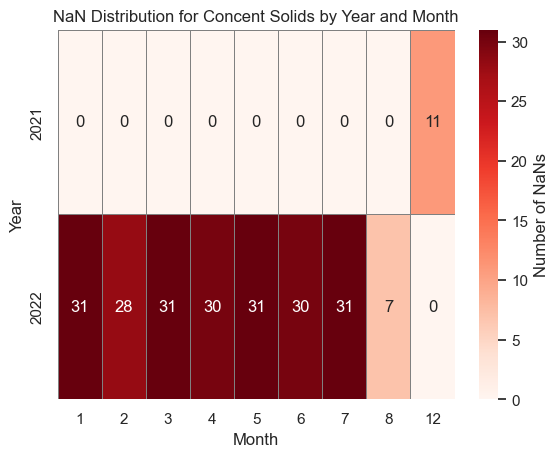

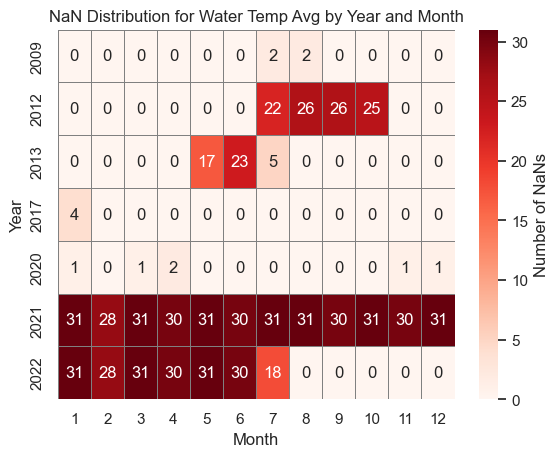

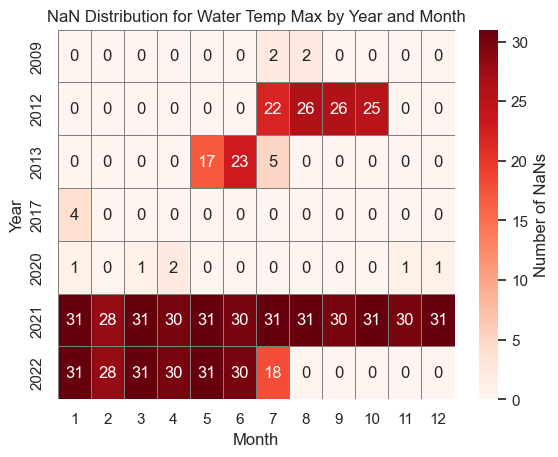

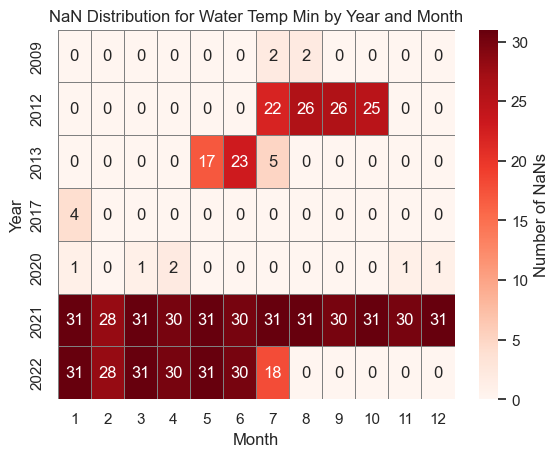

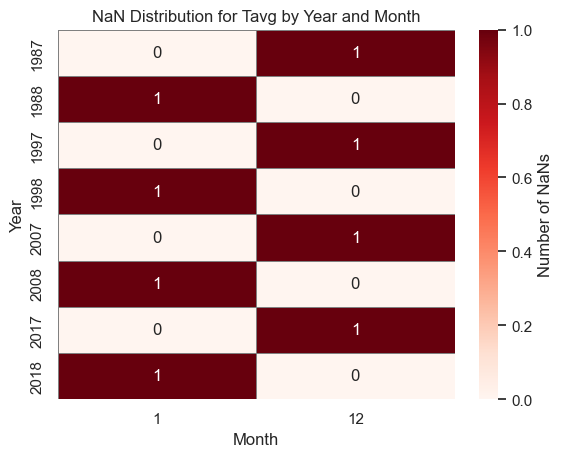

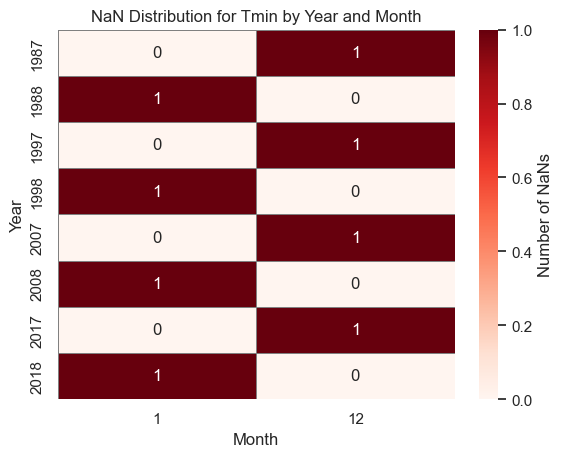

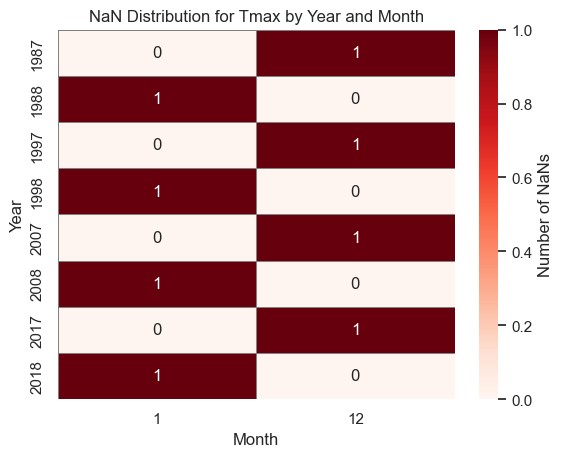

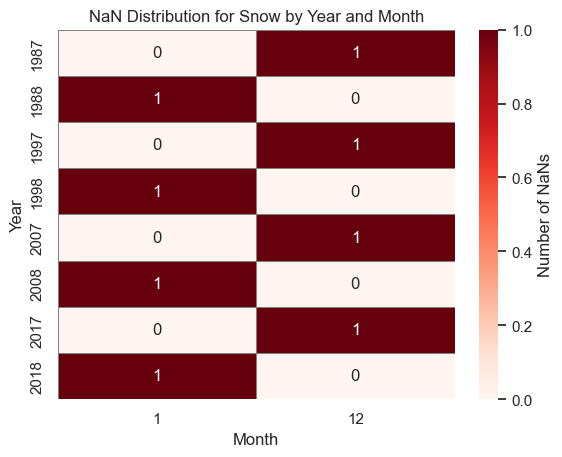

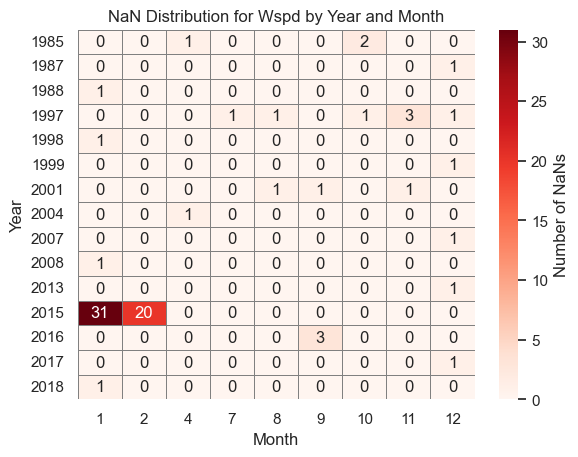

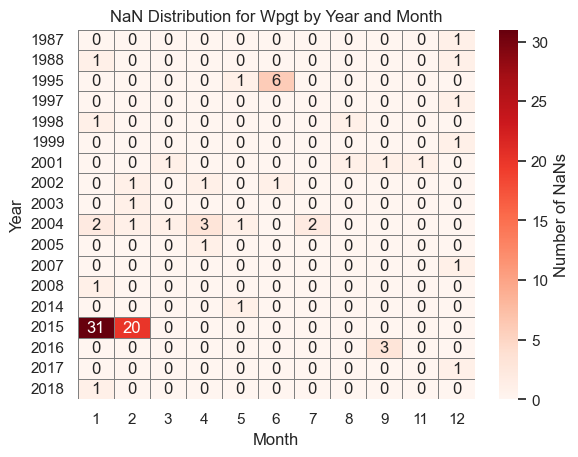

In [65]:
# Plot heatmaps for each variable in list_nans to visualize missing values across time

for col in list_nans:
    # Count NaNs per year and month
    nan_per_month_year = df_river_weather[df_river_weather[col].isna()].groupby(['year', 'month']).size().unstack(fill_value=0)

    # Create heatmap
    sns.heatmap(nan_per_month_year, cmap='Reds', annot=True, fmt='d', linewidths=0.5, linecolor='gray', cbar_kws={'label': 'Number of NaNs'})
    
    # Title & Labels
    plt.title(f"NaN Distribution for {col.replace('_', ' ').title()} by Year and Month")
    plt.xlabel("Month")
    plt.ylabel("Year")
    
    plt.show()  # Display each heatmap


<span style="color:#00BFFF;">
    <h3><b>Results:</b></h3>
    <ul>
        <li>Throughout <b>2021</b> and from <b>January to July 2022</b>, there are extensive missing values in 
        <b>water temperature</b> (avg, min, and max) and <b>concentration of suspended solids</b>.</li>
        <li>These gaps span <b>1.5 years of critical data</b>, which are essential for determining suitable days for 
        <b>swimming and ice bathing</b>.</li>
        <li>To ensure <b>consistent and reliable analyses</b>, the decision has been made to <b>exclude 2021 and 2022 entirely</b>.</li>
        <li>Due to the missing data in <b>2021 and 2022</b>, including <b>2023</b> would not be meaningful.</li>
        <li>The <b>two-year gap</b>, combined with 2023 being the last year available, would result in an <b>inconsistent timeframe</b>.</li>
    </ul>
    <h3><b>Conclusion:</b></h3>
    <ul>
        <li>The years <b>2021, 2022, and 2023</b> will be <b>excluded</b> from further analyses due to 
        <b>incomplete and insufficient data</b>.</li>
        <li>This ensures a <b>consistent timeframe (1985–2020)</b> with <b>complete yearly data and no gaps</b>.</li>
        <li>The <b>next steps</b> include addressing any <b>remaining NaNs</b> in the dataset by applying 
        <b>suitable interpolation methods</b> for smaller gaps.</li>
    </ul>
</span>


In [66]:
# Create a backup copy before removing data from 2021–2023
df_river_weather_before_drop = df_river_weather.copy()

In [67]:
# Exclude the years 2021, 2022, and 2023 to ensure a consistent timeframe (1985–2020)
df_river_weather= df_river_weather[df_river_weather['year'] <= 2020]

# Display updated DataFrame info to verify changes
df_river_weather.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13149 entries, 0 to 13148
Data columns (total 38 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   date                       13149 non-null  datetime64[ns]
 1   flow_avg                   13149 non-null  float64       
 2   flow_max                   13149 non-null  float64       
 3   flow_min                   13149 non-null  float64       
 4   level_avg                  13149 non-null  float64       
 5   level_max                  13149 non-null  float64       
 6   level_min                  13149 non-null  float64       
 7   concent_solids             13149 non-null  float64       
 8   water_temp_avg             12991 non-null  float64       
 9   water_temp_max             12991 non-null  float64       
 10  water_temp_min             12991 non-null  float64       
 11  year                       13149 non-null  int32         
 12  month    

In [68]:
# Count missing values per column
df_river_weather[list_nans].isna().sum()

concent_solids      0
water_temp_avg    158
water_temp_max    158
water_temp_min    158
tavg                8
tmin                8
tmax                8
snow                8
wspd               77
wpgt               92
dtype: int64

<span style="color:#00BFFF;">
    <h2><b>Results:</b></h2>
    <h3>No NaNs in:</h3>
    <ul>
        <li>Water flow (all variables)</li>
        <li>Water level (all variables)</li>
        <li>Concentration of suspended solids</li>
    </ul>
    <h3>NaNs detected in:</h3>
    <ul>
        <li><code>water_temp_avg:</code> 158</li>
        <li><code>water_temp_max:</code> 158</li>
        <li><code>water_temp_min:</code> 158</li>
        <li><code>tavg:</code> 8</li>
        <li><code>tmin:</code> 8</li>
        <li><code>tmax:</code> 8</li>
        <li><code>snow:</code> 216</li>
        <li><code>wspd:</code> 77</li>
        <li><code>wpgt:</code> 92</li>
    </ul>
    <h2>Next Steps:</h2>
    <ol>
        <li><b>Prioritized order:</b> Snow, water_temp, wpgt, wspd, prcp, and tavg</li>
        <li>Check for <b>seasonal patterns</b> in NaNs</li>
        <li>Analyze if certain <b>years</b> have more NaNs than others</li>
    </ol>
</span>


In [69]:
# Updated list of variables with missing values (NaNs)
list_nans_filtered = [col for col in df_river_weather.columns if df_river_weather[col].isna().any()\
                and not col.startswith("is_outlier")\
                and not col.startswith("prcp")\
                and not col.endswith("original")]
list_nans_filtered

['water_temp_avg',
 'water_temp_max',
 'water_temp_min',
 'tavg',
 'tmin',
 'tmax',
 'snow',
 'wspd',
 'wpgt']

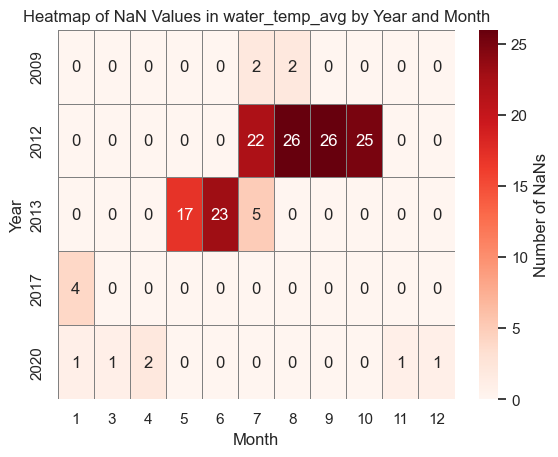

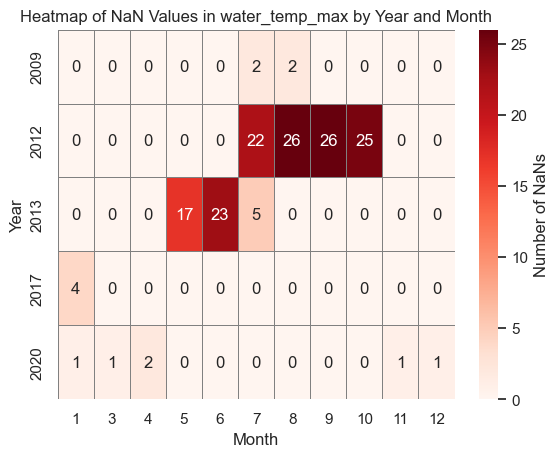

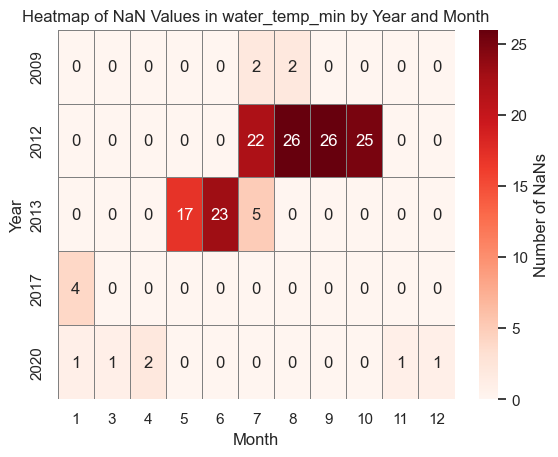

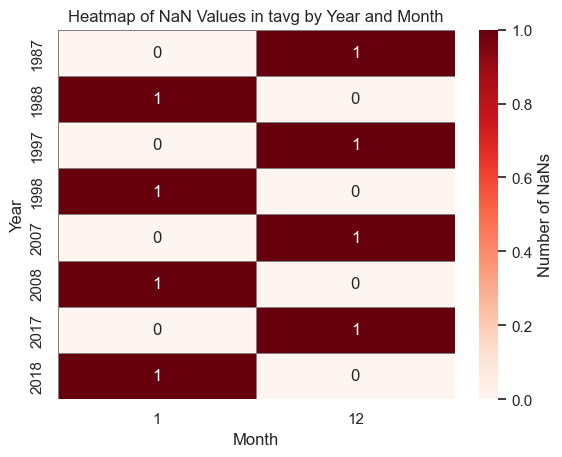

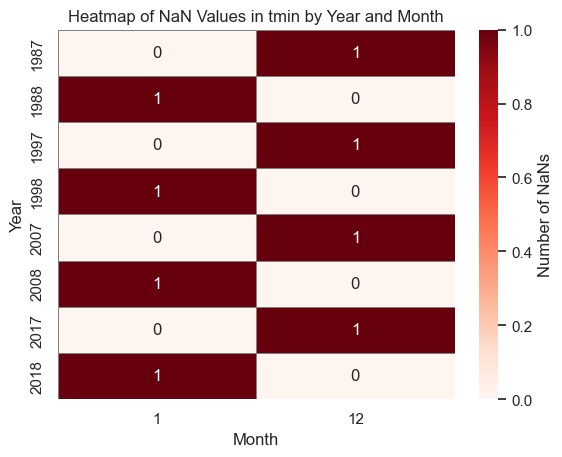

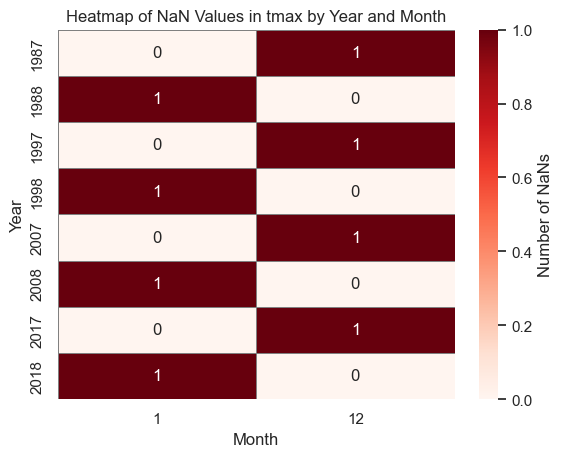

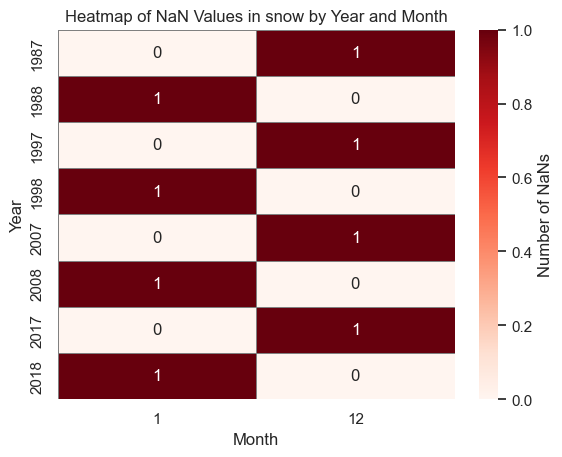

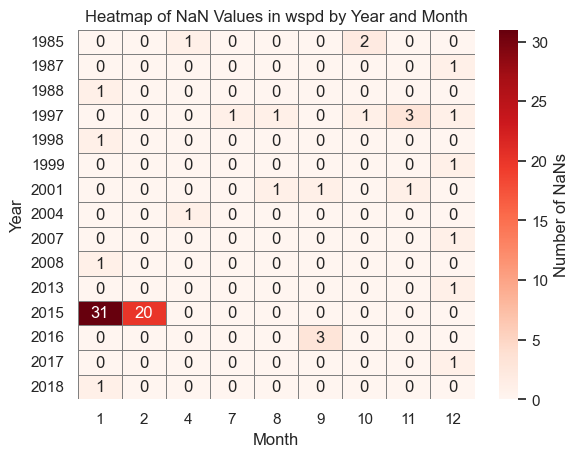

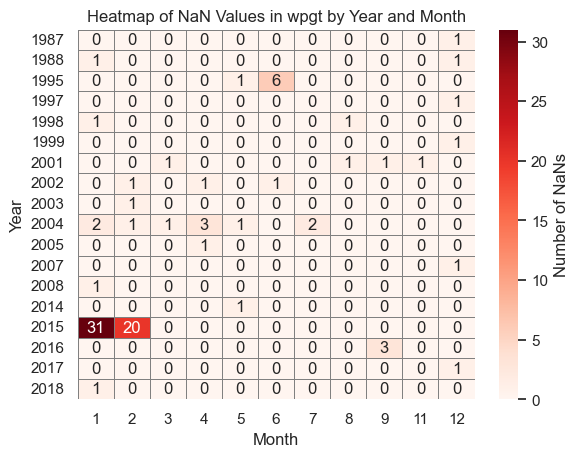

In [70]:
# Plot heatmaps for each variable in list_nans to visualize missing values across time

for col in list_nans_filtered:
    # Count NaNs per year and month
    nan_per_month_year = df_river_weather[df_river_weather[col].isna()].groupby(['year', 'month']).size().unstack(fill_value=0)

    # Create heatmap
    sns.heatmap(nan_per_month_year, cmap='Reds', annot=True, fmt='d', linewidths=0.5, linecolor='gray', cbar_kws={'label': 'Number of NaNs'})

    # Title & Labels
    plt.title(f"Heatmap of NaN Values in {col} by Year and Month")
    plt.xlabel("Month")
    plt.ylabel("Year")

    plt.show()  # Display each heatmap

<span style="color:#00BFFF;">
    <b>Result:</b><br>
    <p>Two different approaches were chosen for handling missing values, based on the observed patterns in the data.</p>
    <ol>
        <li><b>Water temperature (avg, max, min):</b>  
            <p>Since water temperature is a continuous variable with strong temporal dependencies, a tailored imputation method was required:</p>
            <ol>
                <li><b>Isolated missing values:</b> Filled using the mean of the previous and next values (neighbors' mean).</li>
                <li><b>Consecutive missing values (time series gaps):</b> Filled using <code>.interpolate('time')</code> to preserve seasonal and temporal trends.</li>
            </ol>
            <p>Water temperature had longer periods of missing data and a clear seasonal pattern in NaN occurrences. This approach ensures trend continuity while preventing abrupt jumps.</p>
        </li>
        <li><b>Air temperature (avg, min, max), precipitation, snow depth, wind speed, wind peak gust:</b>  
            <p>For these meteorological variables, missing values were more sporadic and showed no strong seasonal patterns in NaN occurrences. Therefore, a different approach was chosen:</p>
            <ol>
                <li><b>Isolated missing values:</b> Filled using the neighbors' mean.</li>
                <li><b>Consecutive missing values (≤7 days):</b> Filled using <code>.interpolate('time')</code> to maintain short-term trend continuity.</li>
                <li><b>Consecutive missing values (>7 days):</b> Replaced with <b>0</b>, assuming no valid measurement was taken during these periods.</li>
            </ol>
            <p>Unlike water temperature, these variables did not exhibit structured seasonal NaN patterns, making a simpler imputation strategy sufficient.</p>
            <p><b>Note:</b> The decision to replace gaps >7 days with 0 was made after extensive testing. Various imputation methods were considered, but setting these gaps to 0 was found to be the most robust and interpretable approach for this dataset.</p>
        </li>
    </ol>
    <p>After analyzing missing value patterns using time-series visualization and heatmaps, it was determined that water temperature required a different imputation strategy than the other variables.</p>
</span>

<span style="color:#00BFFF;">
    <h3>1. Filling Missing Values for Water Temperature</h3>
    <p>Since water temperature has strong temporal dependencies, two imputation methods are applied:</p>
    <ol>
        <li><b>Isolated missing values:</b> Filled using the mean of neighboring values.</li>
        <li><b>Consecutive missing values:</b> Interpolated using the time-based method.</li>
    </ol>
    <p>Additionally, a new column is created for each water temperature variable to store the imputation method used.</p>
</span>

In [71]:
# Create a dictionary to map each water temperature column to its corresponding "filled_status" column
dict_water_temp = {col: f"filled_status_{col}" for col in list_nans_filtered if col.startswith("water_temp")}
dict_water_temp

{'water_temp_avg': 'filled_status_water_temp_avg',
 'water_temp_max': 'filled_status_water_temp_max',
 'water_temp_min': 'filled_status_water_temp_min'}

In [72]:
# Loop through each water temperature column and fill in missing values
for col, status in dict_water_temp.items():

    # Count missing values before filling them (to check later)
    col_nan_counts = df_river_weather[col].isna().sum()
    filled_counts = 0  

    # Create a new column that marks missing values (1 = missing, 0 = not missing)
    df_river_weather['is_nan'] = df_river_weather[col].isna().astype(int)

    # Give each group number of missing values a number
    df_river_weather['nan_group'] = (df_river_weather['is_nan'].diff() != 0).cumsum()

    # Count how many missing values are in each group and save the result
    nan_group_sizes = df_river_weather[df_river_weather['is_nan'] == 1].groupby('nan_group').size().reset_index()
    nan_group_sizes.columns = ['nan_group', 'nan_group_size']  # Rename for clarity

    # Add this information back to the main dataset
    df_river_weather = df_river_weather.merge(nan_group_sizes, on='nan_group', how='left')

    # Fill in missing values if only one value is missing (using the mean of neighboring values)
    mask_1 = (df_river_weather['nan_group_size'] == 1)
    df_river_weather.loc[mask_1, col] = calculate_neighbours_mean(df_river_weather, col)    
    df_river_weather.loc[mask_1, status] = 'filled_with_neighbors_mean'
    filled_counts += df_river_weather[mask_1][col].count()  

    # Set the date column as index before interpolation
    df_river_weather['date_for_index'] = df_river_weather['date']
    df_river_weather.set_index('date_for_index', inplace=True) 

    # Fill in missing values if multiple consecutive values are missing (using time-based interpolation)
    mask_2 = (df_river_weather['nan_group_size'] > 1)
    df_river_weather.loc[mask_2, col] = df_river_weather[col].interpolate('time')
    df_river_weather.loc[mask_2, status] = 'interpolated_value_time'
    filled_counts += df_river_weather[mask_2][col].count()  

    # Remove the extra columns used to find missing value groups
    df_river_weather.drop(columns=['is_nan', 'nan_group', 'nan_group_size'], inplace=True)

    # Print summary to check the results
    print(f"Variable {col}:\
          \nNumber of NaNs before filling: {col_nan_counts}\
          \nNumber of filled values: {filled_counts}\
          \n{df_river_weather[status].value_counts()}\
          \n_______________________________________________")

Variable water_temp_avg:          
Number of NaNs before filling: 158          
Number of filled values: 158          
filled_status_water_temp_avg
interpolated_value_time       152
filled_with_neighbors_mean      6
Name: count, dtype: int64          
_______________________________________________
Variable water_temp_max:          
Number of NaNs before filling: 158          
Number of filled values: 158          
filled_status_water_temp_max
interpolated_value_time       152
filled_with_neighbors_mean      6
Name: count, dtype: int64          
_______________________________________________
Variable water_temp_min:          
Number of NaNs before filling: 158          
Number of filled values: 158          
filled_status_water_temp_min
interpolated_value_time       152
filled_with_neighbors_mean      6
Name: count, dtype: int64          
_______________________________________________


<span style="color:#00BFFF;">
    <h3>2. Filling Missing Values for the Remaining Variables</h3>
    <p>For air temperature, precipitation, snow depth, wind speed, and wind peak gust, a different approach is used.</p>
    <p>These variables do not have a clear seasonal pattern in their missing values, so a simpler method is applied:</p>
    <ol>
        <li><b>Single missing values:</b> Filled using the average of the values before and after.</li>
        <li><b>Up to 7 missing values in a row:</b> Filled using time-based interpolation.</li>
        <li><b>More than 7 missing values in a row:</b> Replaced with 0, assuming no valid measurement was available.</li>
    </ol>
    <p>A new column is added for each variable to show how its missing values were filled.</p>
</span>

In [73]:
# Make a dictionary that connects each variable (except water temperature) to its "filled_status" column

dict_remaining_variables = {
    col: f"filled_status_{col}" for col in list_nans_filtered\
    if not (col.startswith("water_temp"))
    }
dict_remaining_variables

{'tavg': 'filled_status_tavg',
 'tmin': 'filled_status_tmin',
 'tmax': 'filled_status_tmax',
 'snow': 'filled_status_snow',
 'wspd': 'filled_status_wspd',
 'wpgt': 'filled_status_wpgt'}

In [74]:
# Loop through each variable and fill missing values
for col, status in dict_remaining_variables.items():

    # Count missing values before filling them (to check later)
    col_nan_counts = df_river_weather[col].isna().sum()
    filled_counts = 0  

    # Create a new column that marks missing values (1 = missing, 0 = not missing)
    df_river_weather['is_nan'] = df_river_weather[col].isna().astype(int)

    # Give each group number of missing values a number
    df_river_weather['nan_group'] = (df_river_weather['is_nan'].diff() != 0).cumsum()

    # Count how many missing values are in each group and save the result
    nan_group_sizes = df_river_weather[df_river_weather['is_nan'] == 1].groupby('nan_group').size().reset_index()
    nan_group_sizes.columns = ['nan_group', 'nan_group_size']  # Rename for clarity

    # Add this information back to the main dataset
    df_river_weather = df_river_weather.merge(nan_group_sizes, on='nan_group', how='left')

    # Fill in missing values if only one value is missing (using the mean of neighboring values)
    mask_1 = (df_river_weather['nan_group_size'] == 1)
    df_river_weather.loc[mask_1, col] = calculate_neighbours_mean(df_river_weather, col)    
    df_river_weather.loc[mask_1, status] = 'filled_with_neighbors_mean'
    filled_counts += df_river_weather[mask_1][col].count()  

    # Set the date column as index before interpolation
    df_river_weather['date_for_index'] = df_river_weather['date']
    df_river_weather.set_index('date_for_index', inplace=True) 

    # Fill in missing values if multiple consecutive values are missing (using time-based interpolation)
    mask_2 = ((df_river_weather['nan_group_size'] > 1) & (df_river_weather['nan_group_size'] <= 7))
    df_river_weather.loc[mask_2, col] = df_river_weather[col].interpolate('time')
    df_river_weather.loc[mask_2, status] = 'interpolated_value_time'
    filled_counts += df_river_weather[mask_2][col].count()  

    # If more than 7 values are missing in a row, fill with zeros:
    mask_3 = (df_river_weather['nan_group_size'] > 7)
    df_river_weather.loc[mask_3, col] = 0
    df_river_weather.loc[mask_3, status] = 'filled_with_zero'
    filled_counts += df_river_weather[mask_3][col].count()  

    # Remove the extra columns used to find missing value groups
    df_river_weather.drop(columns=['is_nan', 'nan_group', 'nan_group_size'], inplace=True)

    # Print summary to check the results
    print(f"Variable {col}:\
          \nNumber of NaNs before filling: {col_nan_counts}\
          \nNumber of filled values: {filled_counts}\
          \n{df_river_weather[status].value_counts()}\
          \n_______________________________________________")

Variable tavg:          
Number of NaNs before filling: 8          
Number of filled values: 8          
filled_status_tavg
interpolated_value_time    8
Name: count, dtype: int64          
_______________________________________________
Variable tmin:          
Number of NaNs before filling: 8          
Number of filled values: 8          
filled_status_tmin
interpolated_value_time    8
Name: count, dtype: int64          
_______________________________________________
Variable tmax:          
Number of NaNs before filling: 8          
Number of filled values: 8          
filled_status_tmax
interpolated_value_time    8
Name: count, dtype: int64          
_______________________________________________
Variable snow:          
Number of NaNs before filling: 8          
Number of filled values: 8          
filled_status_snow
interpolated_value_time    8
Name: count, dtype: int64          
_______________________________________________
Variable wspd:          
Number of NaNs before filli

In [75]:
df_river_weather[list_nans].isna().sum()

concent_solids    0
water_temp_avg    0
water_temp_max    0
water_temp_min    0
tavg              0
tmin              0
tmax              0
snow              0
wspd              0
wpgt              0
dtype: int64

<span style="color:#00BFFF;">
    <h1>🚀 Coming soon: First insights into the data and its correlations.</h1>
</span>

<h2 id="#eda"> V.) Exploratory Data Analysis (EDA)</h2>

<h3 id="#distributions">A.) Data Distributions & Summary Statistics</h3>
<h3 id="#correlations">B.) Correlations & Relationships</h3>
<h3 id="#trends">C.) Trends Over Time</h3>

<h2 id="calcDays">VI.) Calculation of the Days for Swimming and Taking an Ice Bath</h2>